In [11]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import datetime
import numpy as np
import random
import itertools

In [2]:
def handle_table_to_line(ngành,mã):
    global df1
    df1= pd.read_excel("./%s_data/Price/%s.xlsx"%(ngành,mã))
    # df1.rename(columns={'STT','Ngày','Giá Tham Chiếu','+/- (*)','% (*)','Đóng Cửa (*)','Khối Lượng','Mở Cửa (*)','Cao Nhất (*)','Thấp Nhất (*)','Giao Dịch Thỏa Thuận','Nước Ngoài Mua','Nước Ngoài Bán','Giá Trị(triệu đồng)'})
    df1.columns = [''] * len(df1.columns)
    header = df1.iloc[0].values
    df1.columns = header
    df1.drop(0,inplace=True)
    df1.drop(0,axis=1,inplace=True)
    df = df1[["Đóng Cửa (*)","Ngày"]]
    df.reset_index(inplace=True)
    df["Đóng Cửa (*)"]= df["Đóng Cửa (*)"].astype(float)
    df["Ngày"] = pd.to_datetime(df["Ngày"])
    df.sort_values(by="Ngày",ascending=True,inplace=True)
    
#     MA250= df["Đóng Cửa (*)"].rolling(250).mean()
    
    fig, ax = plt.subplots()     
    fig.set_size_inches(11.7, 8.27)
    sns.lineplot(x='Ngày',y='Đóng Cửa (*)', data = df,ax = ax,sort=False)
    
    plt.savefig('./%s_data/price/linechart/%s.png'%(ngành,mã))
    return df

In [32]:
def corr(ngành,list_stock,mã_đầu):
    global cor_tab

    max_len=list_stock[0]
    for dataC in list_stock:
        A= pd.read_excel("./%s_data/Price/%s.xlsx"%(ngành,dataC))
        if len(A)>len(pd.read_excel("./%s_data/Price/%s.xlsx"%(ngành,max_len))):
            max_len=dataC
        else:
            pass
    
    
    df_head= pd.read_excel("./%s_data/Price/%s.xlsx"%(ngành,max_len))    
    
    
    header = df_head.iloc[0].values
    df_head.columns = header
    df_head.drop(0,inplace=True)
    df_head.drop(0,axis=1,inplace=True)
    df_head["Ngày"] = pd.to_datetime(df_head["Ngày"],dayfirst=True)
    df_head["Đóng Cửa (*)"]= df_head["Đóng Cửa (*)"].astype(float)
    df_head.sort_values(by="Ngày",ascending=True,inplace=True)
    
    cor_tab= pd.DataFrame((df_head[(df_head["Ngày"]>pd.to_datetime('31-12-2016',dayfirst=True))&(df_head["Ngày"]<= pd.to_datetime('01-11-2019',dayfirst=True))])[["Ngày","Đóng Cửa (*)"]])
    
    cor_tab.rename(columns={df_head.columns[6]:"A"})
    for mã in list_stock:
        df2= pd.read_excel("./%s_data/Price/%s.xlsx"%(ngành,mã))
        
        header2 = df2.iloc[0].values
        df2.columns = header2
        df2.drop(0,inplace=True)
        df2.drop(0,axis=1,inplace=True)
        df2["Ngày"] = pd.to_datetime(df2["Ngày"],dayfirst=True)
        df2["Đóng Cửa (*)"]= df2["Đóng Cửa (*)"].astype(float)
        df2.sort_values(by="Ngày",ascending=True,inplace=True)
        
        cor_tab["%s"%mã]= df2[(df2['Ngày'] > pd.to_datetime('31-12-2016',dayfirst=True)) & (df2['Ngày'] <= pd.to_datetime('01-11-2019',dayfirst=True))]["Đóng Cửa (*)"]
        print(list_stock.index(mã), end=" , ")
    cor_tab.drop(columns='Đóng Cửa (*)',inplace=True)
    cor_tab.reset_index(drop=True,inplace=True)
    
    cor_tab.dropna(axis=1, how='all',inplace=True)
#   cor_tab.drop(0,inplace=True)
    return cor_tab

In [5]:
def scater(table,Ngành):
    for mã in table.columns:
        for mã_phụ in table.columns:
            if mã_phụ != mã:
                sns.scatterplot(x= mã, y= mã_phụ,data= cor_tab[[mã,mã_phụ]])
                plt.savefig('./%s_data/price/corr/%s-%s.png'%(Ngành,mã,mã_phụ))
                plt.clf()
            else:
                pass
            print(mã,mã_phụ)
    print("Đã xong")
    return None
            

In [16]:
def indata(data):
    
    global col, prop
    
    col=list(data.columns.values)
    
    try:
        col.remove("Ngày")
    except:
        pass
    
    len_data=len(col)

    prop_rub=[]

    prop=[]

    for i in range(len_data):
        prop_rub.append(random.randint(0,10000))

    # Tính tổng của dãy chỉ số:
    sum_ind=sum(prop_rub)
    
    for things in prop_rub:
        prop.append(things/sum_ind)
    
    return col, prop


In [51]:
def PnL(list_pro,list_data,init_mon,datatab):
    global total_pnl, unna_tab

    unna_tab=datatab.fillna(method="bfill")
    
    list_money=[]
    for pro in list_pro:
        list_money.append(pro*init_mon)
    print(list_data)
    
    list_num=[]
    for money, data in zip(list_money, list_data):
        list_num.append(money/unna_tab[data][0])
#     print(list_num)
    
    data_dict={}
    
    
    for smt, num in zip(list_data,list_num):
#         print(smt,num)
        data_list=[]
        for i in range(len(unna_tab)):
            A= num*unna_tab[smt][i]
        
            
            data_list.append(A)
        
        data_dict.update({smt : data_list})
    
    df_pnl= pd.DataFrame(data=data_dict)
    print(df_pnl)
    total_pnl= df_pnl.sum(axis = 1, skipna = True) - init_mon
    total_pnl=pd.DataFrame(total_pnl)
#     print(datatab["Ngày"])
    total_pnl["Ngày"]=datatab["Ngày"]
    total_pnl.columns=["PNL","Ngày"]
    
    
#     holding_return = 100*((total_pnl[len(total_pnl)-1] - tot_int_val)/tot_int_val)
    fig, ax = plt.subplots()     
    fig.set_size_inches(11.7, 8.27)
    sns.lineplot(x='Ngày',y='PNL', data = total_pnl,ax = ax,sort=False)
    plt.savefig("./Strategy/test.png")
    
    return total_pnl
            
        

In [34]:
data= input("Nhập tên ngành:")
f= open("./%s_data/price/%s.txt" %(data,data), "r")
String_tên_mã= f.read()
list_stocks= String_tên_mã.split(",")
f.close()
try:
    list_stocks.remove("")
except:
    pass

print(len(list_stocks),list_stocks)

Nhập tên ngành:Tài chính
91 ['ABI', 'ACB', 'AGR', 'APG', 'API', 'APS', 'ART', 'ASIAGF', 'AVS', 'BAB', 'BCG', 'BIC', 'BID', 'BLI', 'BMI', 'BMS', 'BSI', 'BVH', 'BVS', 'CSI', 'CTG', 'CTS', 'E1SSHN30', 'E1VFVN30', 'EFI', 'EIB', 'EVS', 'FIT', 'FSC', 'FTS', 'FUCTVGF2', 'GBS', 'HAC', 'HAG', 'HBB', 'HBS', 'HCM', 'HFT', 'HPC', 'HSA', 'IPA', 'IVS', 'KLB', 'KLS', 'LPB', 'MAFPF1', 'MBB', 'MBS', 'MIG', 'MSN', 'NVB', 'ORS', 'PGI', 'PHS', 'PRUBF1', 'PSI', 'PTI', 'PVF', 'PVI', 'SBS', 'SDF', 'SHB', 'SHN', 'SHS', 'SME', 'SSI', 'STB', 'SVS', 'TAS', 'TCB', 'TIG', 'TPB', 'TVB', 'TVC', 'TVS', 'VBB', 'VCB', 'VCI', 'VDS', 'VFMVF1', 'VFMVF4', 'VFMVFA', 'VIB', 'VIB', 'VIG', 'VIX', 'VND', 'VNN', 'VNR', 'VPB', 'WSS']


In [35]:
data1=corr(data,list_stocks,list_stocks[0])

0 , 1 , 2 , 3 , 4 , 5 , 6 , 7 , 8 , 9 , 10 , 11 , 12 , 13 , 14 , 15 , 16 , 17 , 18 , 19 , 20 , 21 , 22 , 23 , 24 , 25 , 26 , 27 , 28 , 29 , 30 , 31 , 32 , 33 , 34 , 35 , 36 , 37 , 38 , 39 , 40 , 41 , 42 , 43 , 44 , 45 , 46 , 47 , 48 , 49 , 50 , 51 , 52 , 53 , 54 , 55 , 56 , 57 , 58 , 59 , 60 , 61 , 62 , 63 , 64 , 65 , 66 , 67 , 68 , 69 , 70 , 71 , 72 , 73 , 74 , 75 , 76 , 77 , 78 , 79 , 80 , 81 , 82 , 82 , 84 , 85 , 86 , 87 , 88 , 89 , 90 , 

In [91]:
# data=data4.merge(data3, how='inner',left_on="Ngày", right_on="Ngày")

In [70]:
# data=data1.drop(columns="Ngày")
# data
data1.columns

Index(['Ngày', 'ABI', 'ACB', 'AGR', 'APG', 'API', 'APS', 'ART', 'BAB', 'BCG',
       'BIC', 'BID', 'BLI', 'BMI', 'BMS', 'BSI', 'BVH', 'BVS', 'CSI', 'CTG',
       'CTS', 'E1VFVN30', 'EFI', 'EIB', 'EVS', 'FIT', 'FSC', 'FTS', 'FUCTVGF2',
       'HAC', 'HAG', 'HBS', 'HCM', 'HFT', 'HSA', 'IPA', 'IVS', 'KLB', 'LPB',
       'MBB', 'MBS', 'MIG', 'MSN', 'NVB', 'ORS', 'PGI', 'PHS', 'PSI', 'PTI',
       'PVI', 'SBS', 'SHB', 'SHN', 'SHS', 'SSI', 'STB', 'TCB', 'TIG', 'TPB',
       'TVB', 'TVC', 'TVS', 'VBB', 'VCB', 'VCI', 'VDS', 'VIB', 'VIG', 'VIX',
       'VND', 'VNR', 'VPB', 'WSS'],
      dtype='object')

In [85]:
indata(data1[["VCB","ABI","SHB","BID"]])

(['VCB', 'ABI', 'SHB', 'BID'],
 [0.28012025554302894,
  0.1872228485531755,
  0.05621946636602781,
  0.47643742953776774])

In [86]:
for pro, stock in zip(prop,col):
    print(pro*100,stock)

28.012025554302895 VCB
18.72228485531755 ABI
5.621946636602781 SHB
47.64374295377677 BID


['VCB', 'ABI', 'SHB', 'BID']
              VCB           ABI            SHB           BID
0    2.801203e+06  1.872228e+06  562194.663660  4.764374e+06
1    2.801203e+06  1.872228e+06  562194.663660  4.764374e+06
2    2.801203e+06  1.872228e+06  562194.663660  4.764374e+06
3    2.801203e+06  1.779114e+06  562194.663660  4.764374e+06
4    2.782523e+06  1.786346e+06  550616.283859  4.764374e+06
..            ...           ...            ...           ...
703  6.849287e+06  2.721105e+06  849081.185391  1.307563e+07
704  6.802587e+06  2.838627e+06  836216.318945  1.304264e+07
705  6.724754e+06  2.847668e+06  861946.051836  1.317462e+07
706  6.833720e+06  2.929030e+06  849081.185391  1.317462e+07
707  6.825937e+06  2.784386e+06  849081.185391  1.304264e+07

[708 rows x 4 columns]


,PNL,Ngày
0,0.000000e+00,2017-01-03
1,0.000000e+00,2017-01-04
2,0.000000e+00,2017-01-05
3,-9.311421e+04,2017-01-06
4,-1.161403e+05,2017-01-09
...,...,...
703,1.349511e+07,2019-10-28
704,1.352007e+07,2019-10-29
705,1.360898e+07,2019-10-30
706,1.378645e+07,2019-10-31


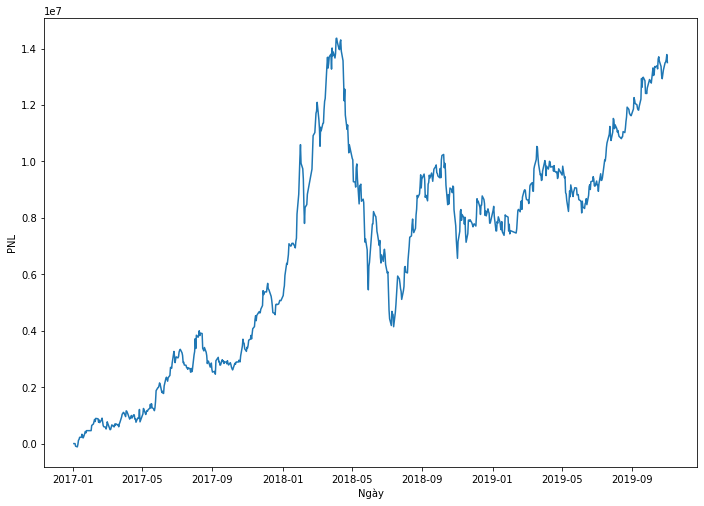

In [87]:
PnL(prop,col,10000000,data1)


C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figu

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C

C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\HP\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\HP\Anaconda3\lib\s

FileNotFoundError: [Errno 2] No such file or directory: './Bất động sản và Xây dựng_data/Price/.xlsx'

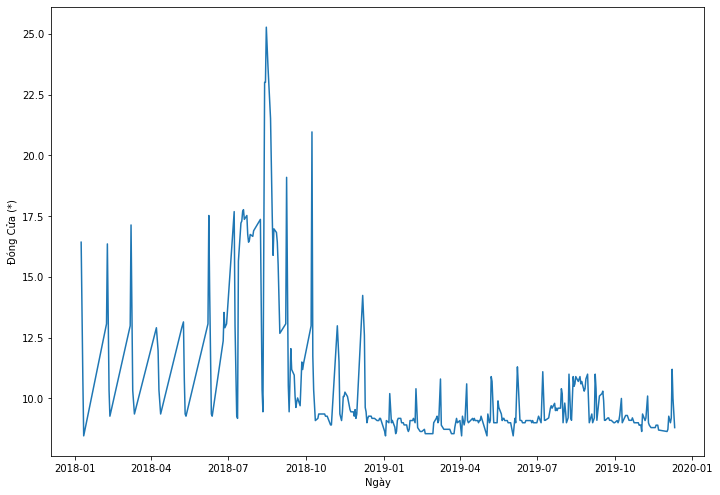

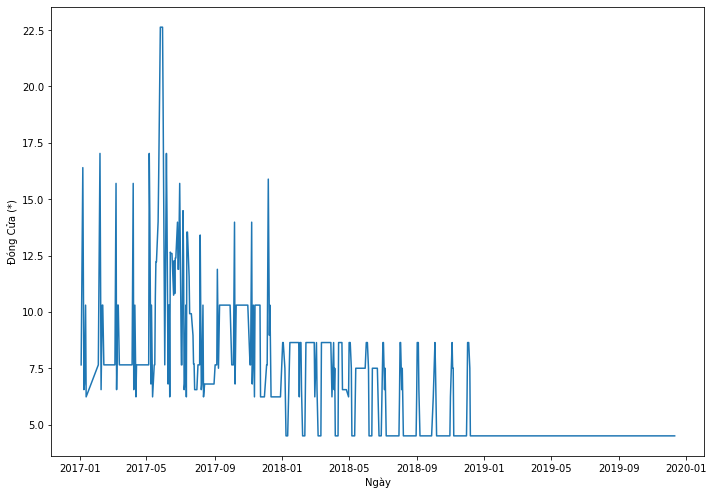

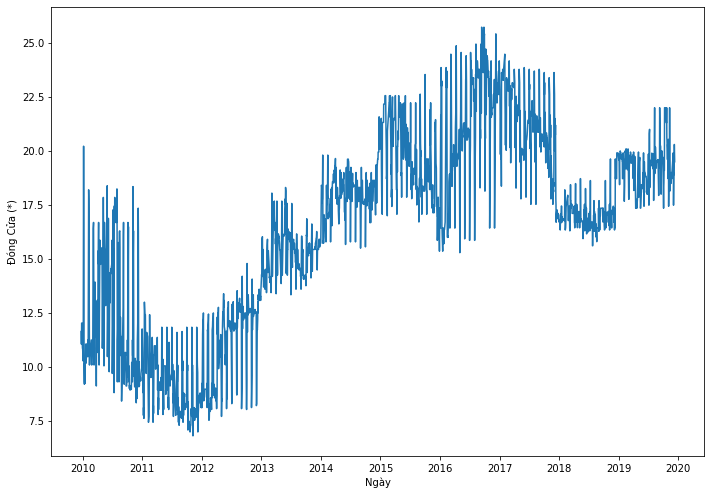

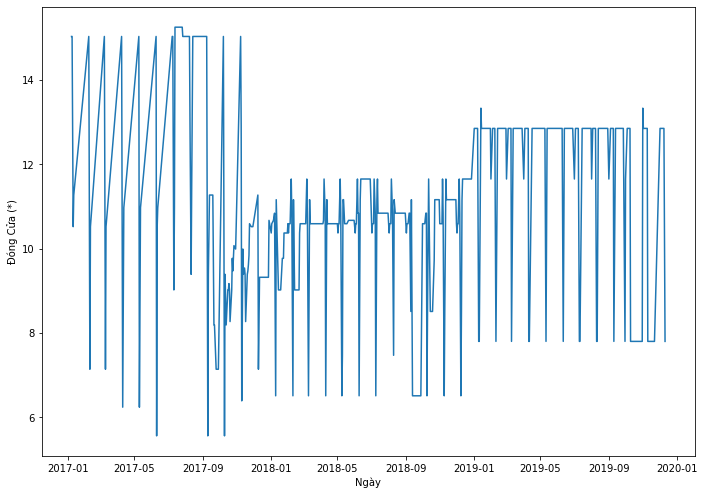

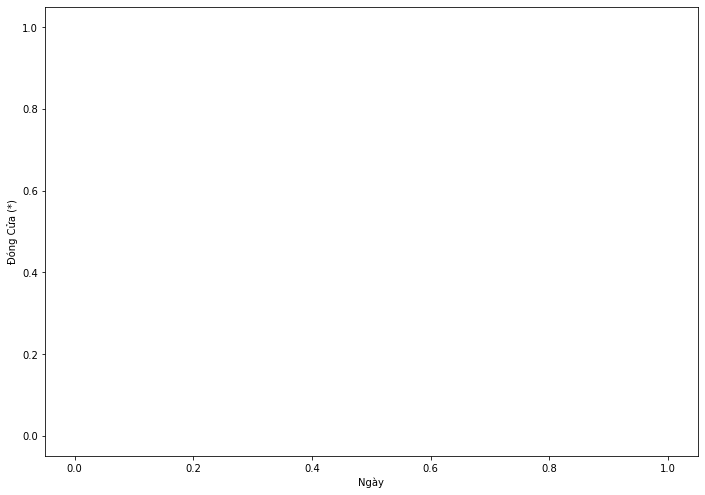

...

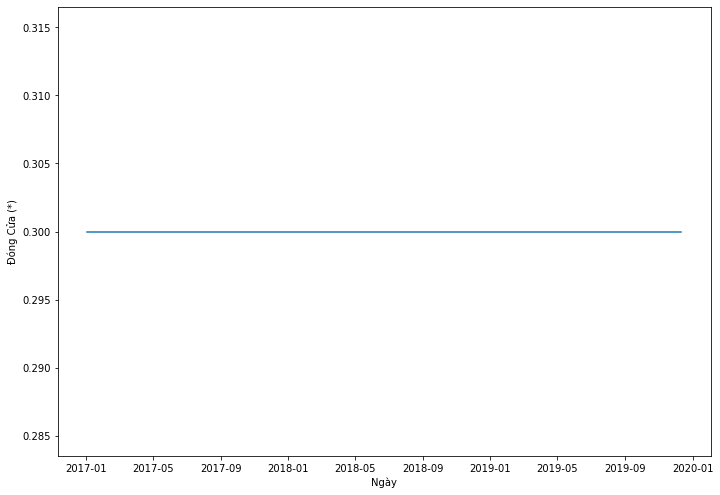

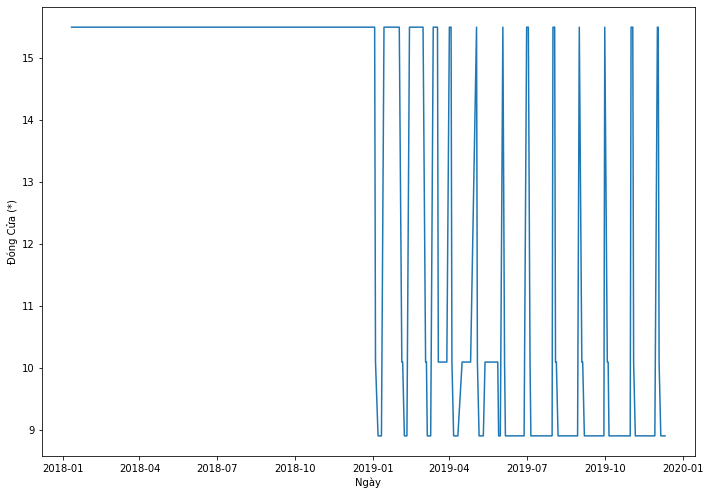

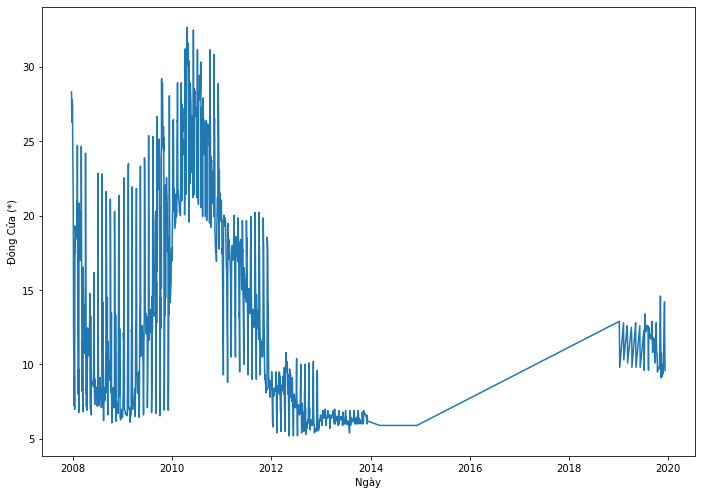

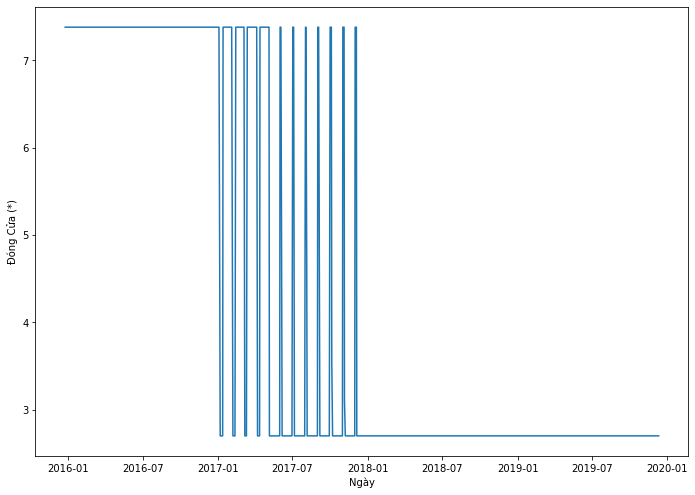

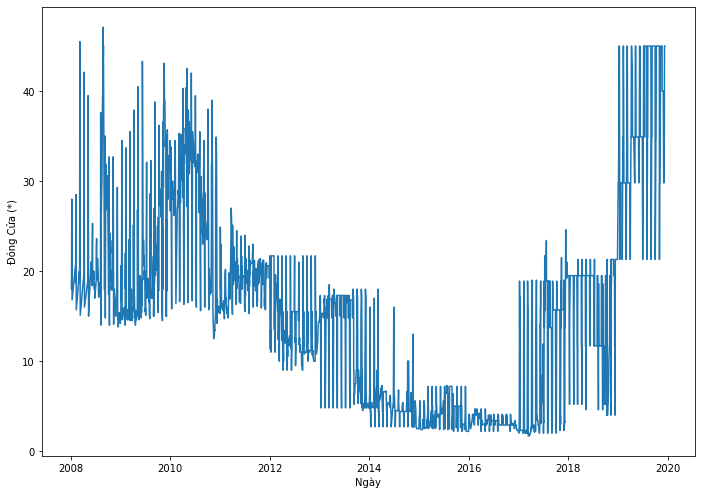

In [21]:
# for stock in A:
#     handle_table_to_line(data,stock)

In [27]:
# cor_tab_2= cor_tab.dropna('columns', how='any')
# cor_tab_2

,AAV,AC4,ACC,ACS,AME,ASD,ASM,ATB,B82,BAX,...,ICC,ICG,ICI,IDC,IDJ,IDV,IJC,INC,ITA,ITC
16,9.10,4.5,20.00,7.80,6.00,3.3,6.60,0.8,0.4,44.00,...,45.10,8.50,8.3,17.64,6.5,36.26,15.20,7.70,3.19,16.00
39,9.00,4.5,19.70,7.80,6.40,5.4,6.65,0.8,0.5,50.00,...,44.40,8.50,8.3,17.44,5.9,34.15,15.70,7.00,3.20,15.65
81,10.20,4.5,19.60,12.85,7.70,9.9,5.47,1.0,1.1,71.10,...,47.00,8.60,8.3,18.51,3.5,35.49,12.30,6.34,3.09,14.70
104,9.00,4.5,18.44,12.85,7.30,9.9,6.21,0.8,1.1,64.00,...,47.40,9.30,8.3,19.20,3.6,28.78,10.60,5.34,3.10,12.30
165,9.09,4.5,19.81,12.85,9.20,5.2,6.90,0.8,1.1,33.87,...,43.39,9.30,8.3,20.78,3.1,26.55,11.20,6.70,3.30,12.10
186,8.46,4.5,19.86,12.85,13.10,5.2,7.14,0.8,1.1,27.49,...,47.54,7.80,8.3,19.46,2.8,27.36,9.98,5.71,2.70,11.26
201,8.64,4.5,19.59,12.85,14.90,5.2,7.14,0.7,1.1,26.51,...,40.14,9.80,8.3,19.83,3.2,25.48,7.90,6.34,2.70,10.62
224,9.18,4.5,19.91,11.65,15.70,5.2,6.83,0.7,1.0,27.69,...,37.89,9.61,8.3,21.83,3.0,23.95,7.55,6.16,3.06,11.08
225,9.18,4.5,19.91,11.65,14.40,4.6,7.00,0.7,1.0,27.69,...,40.60,9.61,8.3,19.93,3.1,23.95,7.68,6.16,3.16,10.98
226,9.09,4.5,19.91,11.65,14.40,4.6,7.35,0.8,1.0,27.69,...,40.60,9.70,8.3,18.98,3.0,23.95,7.53,6.16,3.17,10.80


AAV AAV
AAV AC4
AAV ACC
AAV ACS
AAV ALP
AAV AME
AAV ASD
AAV ASM
AAV ATB
AAV B82
AAV BAX
AAV BCC
AAV BCE
AAV BCI
AAV BCM
AAV BDC
AAV BDT
AAV BHC
AAV BHT
AAV BHV
AAV BII
AAV BM9
AAV BMP
AAV BT6
AAV BTD
AAV BTN
AAV BTS
AAV BTU
AAV C12
AAV C21
AAV C32
AAV C36
AAV C47
AAV C4G
AAV C69
AAV C71
AAV C92
AAV CBI
AAV CC1
AAV CC4
AAV CCH
AAV CCI
AAV CCL
AAV CCM
AAV CCV
AAV CDC
AAV CDG
AAV CDO
AAV CDR
AAV CEE
AAV CEO
AAV CGV
AAV CH5
AAV CI5
AAV CIC
AAV CID
AAV CIG
AAV CIP
AAV CLG
AAV CLH
AAV CMD
AAV CNN
AAV CNT
AAV CPW
AAV CRC
AAV CRE
AAV CSC
AAV CT3
AAV CT6
AAV CTD
AAV CTI
AAV CTM
AAV CTN
AAV CVN
AAV CVT
AAV CX8
AAV CYC
AAV D11
AAV D26
AAV D2D
AAV DAC
AAV DAG
AAV DC1
AAV DC2
AAV DC4
AAV DCC
AAV DCF
AAV DCR
AAV DCT
AAV DGT
AAV DHA
AAV DIC
AAV DID
AAV DIG
AAV DIH
AAV DLG
AAV DLR
AAV DNC
AAV DND
AAV DNP
AAV DPC
AAV DPG
AAV DPS
AAV DRH
AAV DSG
AAV DTA
AAV DTC
AAV DTD
AAV DTI
AAV DTV
AAV DX2
AAV DXG
AAV DXV
AAV E29
AAV EVG
AAV FIC
AAV FIR
AAV FLC
AAV FPC
AAV G36
AAV GAB
AAV GKM
AAV GMX
AAV GND
AAV GTH


ACC HBC
ACC HC3
ACC HCC
ACC HCI
ACC HD2
ACC HDC
ACC HDG
ACC HEC
ACC HEJ
ACC HFB
ACC HHL
ACC HHV
ACC HID
ACC HLD
ACC HLY
ACC HMC
ACC HMS
ACC HOM
ACC HPR
ACC HPS
ACC HPX
ACC HQC
ACC HT1
ACC HT2
ACC HTB
ACC HTE
ACC HTN
ACC HTT
ACC HU1
ACC HU3
ACC HU4
ACC HU6
ACC HUB
ACC HUT
ACC HVX
ACC ICC
ACC ICG
ACC ICI
ACC IDC
ACC IDJ
ACC IDV
ACC IJC
ACC INC
ACC ITA
ACC ITC
ACC JSC
ACC KAC
ACC KBC
ACC KBT
ACC KDH
ACC KHA
ACC KHL
ACC KKC
ACC KMT
ACC KOS
ACC KPF
ACC KSB
ACC KTT
ACC L10
ACC L14
ACC L18
ACC L35
ACC L43
ACC L44
ACC L61
ACC L62
ACC LAI
ACC LBM
ACC LCC
ACC LCD
ACC LCG
ACC LCS
ACC LDG
ACC LEC
ACC LGL
ACC LHC
ACC LHG
ACC LIC
ACC LIG
ACC LM3
ACC LM7
ACC LM8
ACC LMI
ACC LO5
ACC LUT
ACC MAX
ACC MCC
ACC MCG
ACC MCI
ACC MCL
ACC MCO
ACC MCV
ACC MDG
ACC MEC
ACC MES
ACC MH3
ACC MVC
ACC NAC
ACC NAV
ACC NBB
ACC ND2
ACC NDN
ACC NDX
ACC NHA
ACC NHC
ACC NHN
ACC NLG
ACC NMK
ACC NNC
ACC NPH
ACC NRC
ACC NSN
ACC NTB
ACC NTC
ACC NTL
ACC NTP
ACC NVC
ACC NVL
ACC NVN
ACC NVT
ACC OCH
ACC OGC
ACC PC1
ACC PCC
ACC PCM


ALP PHC
ALP PHH
ALP PHR
ALP PNT
ALP PPE
ALP PPI
ALP PSG
ALP PTD
ALP PTE
ALP PTL
ALP PTO
ALP PV2
ALP PVA
ALP PVE
ALP PVL
ALP PVR
ALP PVV
ALP PVX
ALP PXA
ALP PXC
ALP PXI
ALP PXL
ALP PXM
ALP PXS
ALP PXT
ALP QCC
ALP QCG
ALP QNC
ALP QTC
ALP RCD
ALP RCL
ALP REE
ALP ROS
ALP S12
ALP S27
ALP S55
ALP S64
ALP S72
ALP S74
ALP S91
ALP S96
ALP S99
ALP SAM
ALP SC5
ALP SCC
ALP SCI
ALP SCJ
ALP SCL
ALP SCR
ALP SD1
ALP SD2
ALP SD3
ALP SD4
ALP SD5
ALP SD6
ALP SD7
ALP SD8
ALP SD9
ALP SDB
ALP SDC
ALP SDD
ALP SDE
ALP SDG
ALP SDH
ALP SDI
ALP SDJ
ALP SDP
ALP SDS
ALP SDT
ALP SDU
ALP SDX
ALP SDY
ALP SEL
ALP SGR
ALP SHG
ALP SIC
ALP SIG
ALP SII
ALP SIP
ALP SJC
ALP SJE
ALP SJG
ALP SJM
ALP SJS
ALP SKS
ALP SMC
ALP SNG
ALP SNZ
ALP SSS
ALP STL
ALP STV
ALP SVN
ALP SZC
ALP SZL
ALP TA3
ALP TA6
ALP TA9
ALP TBT
ALP TBX
ALP TCD
ALP TCR
ALP TDC
ALP TDH
ALP TEC
ALP TEG
ALP TGG
ALP THG
ALP THS
ALP TIP
ALP TIX
ALP TKC
ALP TKU
ALP TL4
ALP TLD
ALP TLT
ALP TN1
ALP TNI
ALP TNM
ALP TNY
ALP TRT
ALP TS3
ALP TSM
ALP TTB
ALP TTC
ALP TTL


ASD TVG
ASD TXM
ASD UDC
ASD UDJ
ASD UIC
ASD USC
ASD V11
ASD V12
ASD V15
ASD V21
ASD VBG
ASD VC1
ASD VC2
ASD VC3
ASD VC5
ASD VC6
ASD VC7
ASD VC9
ASD VCC
ASD VCG
ASD VCH
ASD VCR
ASD VCS
ASD VCX
ASD VE1
ASD VE2
ASD VE3
ASD VE4
ASD VE8
ASD VE9
ASD VES
ASD VGC
ASD VGV
ASD VHD
ASD VHH
ASD VHL
ASD VHM
ASD VIC
ASD VIH
ASD VIT
ASD VMC
ASD VNE
ASD VNI
ASD VPH
ASD VPI
ASD VPL
ASD VRC
ASD VRE
ASD VTA
ASD VTS
ASD VTV
ASD VVN
ASD VXB
ASD X18
ASD X77
ASD XDH
ASD XMC
ASD XMD
ASD YBC
ASM AAV
ASM AC4
ASM ACC
ASM ACS
ASM ALP
ASM AME
ASM ASD
ASM ASM
ASM ATB
ASM B82
ASM BAX
ASM BCC
ASM BCE
ASM BCI
ASM BCM
ASM BDC
ASM BDT
ASM BHC
ASM BHT
ASM BHV
ASM BII
ASM BM9
ASM BMP
ASM BT6
ASM BTD
ASM BTN
ASM BTS
ASM BTU
ASM C12
ASM C21
ASM C32
ASM C36
ASM C47
ASM C4G
ASM C69
ASM C71
ASM C92
ASM CBI
ASM CC1
ASM CC4
ASM CCH
ASM CCI
ASM CCL
ASM CCM
ASM CCV
ASM CDC
ASM CDG
ASM CDO
ASM CDR
ASM CEE
ASM CEO
ASM CGV
ASM CH5
ASM CI5
ASM CIC
ASM CID
ASM CIG
ASM CIP
ASM CLG
ASM CLH
ASM CMD
ASM CNN
ASM CNT
ASM CPW
ASM CRC
ASM CRE


B82 CTM
B82 CTN
B82 CVN
B82 CVT
B82 CX8
B82 CYC
B82 D11
B82 D26
B82 D2D
B82 DAC
B82 DAG
B82 DC1
B82 DC2
B82 DC4
B82 DCC
B82 DCF
B82 DCR
B82 DCT
B82 DGT
B82 DHA
B82 DIC
B82 DID
B82 DIG
B82 DIH
B82 DLG
B82 DLR
B82 DNC
B82 DND
B82 DNP
B82 DPC
B82 DPG
B82 DPS
B82 DRH
B82 DSG
B82 DTA
B82 DTC
B82 DTD
B82 DTI
B82 DTV
B82 DX2
B82 DXG
B82 DXV
B82 E29
B82 EVG
B82 FIC
B82 FIR
B82 FLC
B82 FPC
B82 G36
B82 GAB
B82 GKM
B82 GMX
B82 GND
B82 GTH
B82 GTS
B82 HAM
B82 HAN
B82 HAR
B82 HAS
B82 HBC
B82 HC3
B82 HCC
B82 HCI
B82 HD2
B82 HDC
B82 HDG
B82 HEC
B82 HEJ
B82 HFB
B82 HHL
B82 HHV
B82 HID
B82 HLD
B82 HLY
B82 HMC
B82 HMS
B82 HOM
B82 HPR
B82 HPS
B82 HPX
B82 HQC
B82 HT1
B82 HT2
B82 HTB
B82 HTE
B82 HTN
B82 HTT
B82 HU1
B82 HU3
B82 HU4
B82 HU6
B82 HUB
B82 HUT
B82 HVX
B82 ICC
B82 ICG
B82 ICI
B82 IDC
B82 IDJ
B82 IDV
B82 IJC
B82 INC
B82 ITA
B82 ITC
B82 JSC
B82 KAC
B82 KBC
B82 KBT
B82 KDH
B82 KHA
B82 KHL
B82 KKC
B82 KMT
B82 KOS
B82 KPF
B82 KSB
B82 KTT
B82 L10
B82 L14
B82 L18
B82 L35
B82 L43
B82 L44
B82 L61
B82 L62


BCI SDX
BCI SDY
BCI SEL
BCI SGR
BCI SHG
BCI SIC
BCI SIG
BCI SII
BCI SIP
BCI SJC
BCI SJE
BCI SJG
BCI SJM
BCI SJS
BCI SKS
BCI SMC
BCI SNG
BCI SNZ
BCI SSS
BCI STL
BCI STV
BCI SVN
BCI SZC
BCI SZL
BCI TA3
BCI TA6
BCI TA9
BCI TBT
BCI TBX
BCI TCD
BCI TCR
BCI TDC
BCI TDH
BCI TEC
BCI TEG
BCI TGG
BCI THG
BCI THS
BCI TIP
BCI TIX
BCI TKC
BCI TKU
BCI TL4
BCI TLD
BCI TLT
BCI TN1
BCI TNI
BCI TNM
BCI TNY
BCI TRT
BCI TS3
BCI TSM
BCI TTB
BCI TTC
BCI TTL
BCI TTZ
BCI TV1
BCI TV2
BCI TV3
BCI TV4
BCI TVG
BCI TXM
BCI UDC
BCI UDJ
BCI UIC
BCI USC
BCI V11
BCI V12
BCI V15
BCI V21
BCI VBG
BCI VC1
BCI VC2
BCI VC3
BCI VC5
BCI VC6
BCI VC7
BCI VC9
BCI VCC
BCI VCG
BCI VCH
BCI VCR
BCI VCS
BCI VCX
BCI VE1
BCI VE2
BCI VE3
BCI VE4
BCI VE8
BCI VE9
BCI VES
BCI VGC
BCI VGV
BCI VHD
BCI VHH
BCI VHL
BCI VHM
BCI VIC
BCI VIH
BCI VIT
BCI VMC
BCI VNE
BCI VNI
BCI VPH
BCI VPI
BCI VPL
BCI VRC
BCI VRE
BCI VTA
BCI VTS
BCI VTV
BCI VVN
BCI VXB
BCI X18
BCI X77
BCI XDH
BCI XMC
BCI XMD
BCI YBC
BCM AAV
BCM AC4
BCM ACC
BCM ACS
BCM ALP
BCM AME


BDT BCC
BDT BCE
BDT BCI
BDT BCM
BDT BDC
BDT BDT
BDT BHC
BDT BHT
BDT BHV
BDT BII
BDT BM9
BDT BMP
BDT BT6
BDT BTD
BDT BTN
BDT BTS
BDT BTU
BDT C12
BDT C21
BDT C32
BDT C36
BDT C47
BDT C4G
BDT C69
BDT C71
BDT C92
BDT CBI
BDT CC1
BDT CC4
BDT CCH
BDT CCI
BDT CCL
BDT CCM
BDT CCV
BDT CDC
BDT CDG
BDT CDO
BDT CDR
BDT CEE
BDT CEO
BDT CGV
BDT CH5
BDT CI5
BDT CIC
BDT CID
BDT CIG
BDT CIP
BDT CLG
BDT CLH
BDT CMD
BDT CNN
BDT CNT
BDT CPW
BDT CRC
BDT CRE
BDT CSC
BDT CT3
BDT CT6
BDT CTD
BDT CTI
BDT CTM
BDT CTN
BDT CVN
BDT CVT
BDT CX8
BDT CYC
BDT D11
BDT D26
BDT D2D
BDT DAC
BDT DAG
BDT DC1
BDT DC2
BDT DC4
BDT DCC
BDT DCF
BDT DCR
BDT DCT
BDT DGT
BDT DHA
BDT DIC
BDT DID
BDT DIG
BDT DIH
BDT DLG
BDT DLR
BDT DNC
BDT DND
BDT DNP
BDT DPC
BDT DPG
BDT DPS
BDT DRH
BDT DSG
BDT DTA
BDT DTC
BDT DTD
BDT DTI
BDT DTV
BDT DX2
BDT DXG
BDT DXV
BDT E29
BDT EVG
BDT FIC
BDT FIR
BDT FLC
BDT FPC
BDT G36
BDT GAB
BDT GKM
BDT GMX
BDT GND
BDT GTH
BDT GTS
BDT HAM
BDT HAN
BDT HAR
BDT HAS
BDT HBC
BDT HC3
BDT HCC
BDT HCI
BDT HD2
BDT HDC


BHT HHV
BHT HID
BHT HLD
BHT HLY
BHT HMC
BHT HMS
BHT HOM
BHT HPR
BHT HPS
BHT HPX
BHT HQC
BHT HT1
BHT HT2
BHT HTB
BHT HTE
BHT HTN
BHT HTT
BHT HU1
BHT HU3
BHT HU4
BHT HU6
BHT HUB
BHT HUT
BHT HVX
BHT ICC
BHT ICG
BHT ICI
BHT IDC
BHT IDJ
BHT IDV
BHT IJC
BHT INC
BHT ITA
BHT ITC
BHT JSC
BHT KAC
BHT KBC
BHT KBT
BHT KDH
BHT KHA
BHT KHL
BHT KKC
BHT KMT
BHT KOS
BHT KPF
BHT KSB
BHT KTT
BHT L10
BHT L14
BHT L18
BHT L35
BHT L43
BHT L44
BHT L61
BHT L62
BHT LAI
BHT LBM
BHT LCC
BHT LCD
BHT LCG
BHT LCS
BHT LDG
BHT LEC
BHT LGL
BHT LHC
BHT LHG
BHT LIC
BHT LIG
BHT LM3
BHT LM7
BHT LM8
BHT LMI
BHT LO5
BHT LUT
BHT MAX
BHT MCC
BHT MCG
BHT MCI
BHT MCL
BHT MCO
BHT MCV
BHT MDG
BHT MEC
BHT MES
BHT MH3
BHT MVC
BHT NAC
BHT NAV
BHT NBB
BHT ND2
BHT NDN
BHT NDX
BHT NHA
BHT NHC
BHT NHN
BHT NLG
BHT NMK
BHT NNC
BHT NPH
BHT NRC
BHT NSN
BHT NTB
BHT NTC
BHT NTL
BHT NTP
BHT NVC
BHT NVL
BHT NVN
BHT NVT
BHT OCH
BHT OGC
BHT PC1
BHT PCC
BHT PCM
BHT PDB
BHT PDR
BHT PEN
BHT PFL
BHT PHC
BHT PHH
BHT PHR
BHT PNT
BHT PPE
BHT PPI
BHT PSG


BII PV2
BII PVA
BII PVE
BII PVL
BII PVR
BII PVV
BII PVX
BII PXA
BII PXC
BII PXI
BII PXL
BII PXM
BII PXS
BII PXT
BII QCC
BII QCG
BII QNC
BII QTC
BII RCD
BII RCL
BII REE
BII ROS
BII S12
BII S27
BII S55
BII S64
BII S72
BII S74
BII S91
BII S96
BII S99
BII SAM
BII SC5
BII SCC
BII SCI
BII SCJ
BII SCL
BII SCR
BII SD1
BII SD2
BII SD3
BII SD4
BII SD5
BII SD6
BII SD7
BII SD8
BII SD9
BII SDB
BII SDC
BII SDD
BII SDE
BII SDG
BII SDH
BII SDI
BII SDJ
BII SDP
BII SDS
BII SDT
BII SDU
BII SDX
BII SDY
BII SEL
BII SGR
BII SHG
BII SIC
BII SIG
BII SII
BII SIP
BII SJC
BII SJE
BII SJG
BII SJM
BII SJS
BII SKS
BII SMC
BII SNG
BII SNZ
BII SSS
BII STL
BII STV
BII SVN
BII SZC
BII SZL
BII TA3
BII TA6
BII TA9
BII TBT
BII TBX
BII TCD
BII TCR
BII TDC
BII TDH
BII TEC
BII TEG
BII TGG
BII THG
BII THS
BII TIP
BII TIX
BII TKC
BII TKU
BII TL4
BII TLD
BII TLT
BII TN1
BII TNI
BII TNM
BII TNY
BII TRT
BII TS3
BII TSM
BII TTB
BII TTC
BII TTL
BII TTZ
BII TV1
BII TV2
BII TV3
BII TV4
BII TVG
BII TXM
BII UDC
BII UDJ
BII UIC
BII USC


BMP VC1
BMP VC2
BMP VC3
BMP VC5
BMP VC6
BMP VC7
BMP VC9
BMP VCC
BMP VCG
BMP VCH
BMP VCR
BMP VCS
BMP VCX
BMP VE1
BMP VE2
BMP VE3
BMP VE4
BMP VE8
BMP VE9
BMP VES
BMP VGC
BMP VGV
BMP VHD
BMP VHH
BMP VHL
BMP VHM
BMP VIC
BMP VIH
BMP VIT
BMP VMC
BMP VNE
BMP VNI
BMP VPH
BMP VPI
BMP VPL
BMP VRC
BMP VRE
BMP VTA
BMP VTS
BMP VTV
BMP VVN
BMP VXB
BMP X18
BMP X77
BMP XDH
BMP XMC
BMP XMD
BMP YBC
BT6 AAV
BT6 AC4
BT6 ACC
BT6 ACS
BT6 ALP
BT6 AME
BT6 ASD
BT6 ASM
BT6 ATB
BT6 B82
BT6 BAX
BT6 BCC
BT6 BCE
BT6 BCI
BT6 BCM
BT6 BDC
BT6 BDT
BT6 BHC
BT6 BHT
BT6 BHV
BT6 BII
BT6 BM9
BT6 BMP
BT6 BT6
BT6 BTD
BT6 BTN
BT6 BTS
BT6 BTU
BT6 C12
BT6 C21
BT6 C32
BT6 C36
BT6 C47
BT6 C4G
BT6 C69
BT6 C71
BT6 C92
BT6 CBI
BT6 CC1
BT6 CC4
BT6 CCH
BT6 CCI
BT6 CCL
BT6 CCM
BT6 CCV
BT6 CDC
BT6 CDG
BT6 CDO
BT6 CDR
BT6 CEE
BT6 CEO
BT6 CGV
BT6 CH5
BT6 CI5
BT6 CIC
BT6 CID
BT6 CIG
BT6 CIP
BT6 CLG
BT6 CLH
BT6 CMD
BT6 CNN
BT6 CNT
BT6 CPW
BT6 CRC
BT6 CRE
BT6 CSC
BT6 CT3
BT6 CT6
BT6 CTD
BT6 CTI
BT6 CTM
BT6 CTN
BT6 CVN
BT6 CVT
BT6 CX8
BT6 CYC


BTN DAG
BTN DC1
BTN DC2
BTN DC4
BTN DCC
BTN DCF
BTN DCR
BTN DCT
BTN DGT
BTN DHA
BTN DIC
BTN DID
BTN DIG
BTN DIH
BTN DLG
BTN DLR
BTN DNC
BTN DND
BTN DNP
BTN DPC
BTN DPG
BTN DPS
BTN DRH
BTN DSG
BTN DTA
BTN DTC
BTN DTD
BTN DTI
BTN DTV
BTN DX2
BTN DXG
BTN DXV
BTN E29
BTN EVG
BTN FIC
BTN FIR
BTN FLC
BTN FPC
BTN G36
BTN GAB
BTN GKM
BTN GMX
BTN GND
BTN GTH
BTN GTS
BTN HAM
BTN HAN
BTN HAR
BTN HAS
BTN HBC
BTN HC3
BTN HCC
BTN HCI
BTN HD2
BTN HDC
BTN HDG
BTN HEC
BTN HEJ
BTN HFB
BTN HHL
BTN HHV
BTN HID
BTN HLD
BTN HLY
BTN HMC
BTN HMS
BTN HOM
BTN HPR
BTN HPS
BTN HPX
BTN HQC
BTN HT1
BTN HT2
BTN HTB
BTN HTE
BTN HTN
BTN HTT
BTN HU1
BTN HU3
BTN HU4
BTN HU6
BTN HUB
BTN HUT
BTN HVX
BTN ICC
BTN ICG
BTN ICI
BTN IDC
BTN IDJ
BTN IDV
BTN IJC
BTN INC
BTN ITA
BTN ITC
BTN JSC
BTN KAC
BTN KBC
BTN KBT
BTN KDH
BTN KHA
BTN KHL
BTN KKC
BTN KMT
BTN KOS
BTN KPF
BTN KSB
BTN KTT
BTN L10
BTN L14
BTN L18
BTN L35
BTN L43
BTN L44
BTN L61
BTN L62
BTN LAI
BTN LBM
BTN LCC
BTN LCD
BTN LCG
BTN LCS
BTN LDG
BTN LEC
BTN LGL
BTN LHC


BTU LM7
BTU LM8
BTU LMI
BTU LO5
BTU LUT
BTU MAX
BTU MCC
BTU MCG
BTU MCI
BTU MCL
BTU MCO
BTU MCV
BTU MDG
BTU MEC
BTU MES
BTU MH3
BTU MVC
BTU NAC
BTU NAV
BTU NBB
BTU ND2
BTU NDN
BTU NDX
BTU NHA
BTU NHC
BTU NHN
BTU NLG
BTU NMK
BTU NNC
BTU NPH
BTU NRC
BTU NSN
BTU NTB
BTU NTC
BTU NTL
BTU NTP
BTU NVC
BTU NVL
BTU NVN
BTU NVT
BTU OCH
BTU OGC
BTU PC1
BTU PCC
BTU PCM
BTU PDB
BTU PDR
BTU PEN
BTU PFL
BTU PHC
BTU PHH
BTU PHR
BTU PNT
BTU PPE
BTU PPI
BTU PSG
BTU PTD
BTU PTE
BTU PTL
BTU PTO
BTU PV2
BTU PVA
BTU PVE
BTU PVL
BTU PVR
BTU PVV
BTU PVX
BTU PXA
BTU PXC
BTU PXI
BTU PXL
BTU PXM
BTU PXS
BTU PXT
BTU QCC
BTU QCG
BTU QNC
BTU QTC
BTU RCD
BTU RCL
BTU REE
BTU ROS
BTU S12
BTU S27
BTU S55
BTU S64
BTU S72
BTU S74
BTU S91
BTU S96
BTU S99
BTU SAM
BTU SC5
BTU SCC
BTU SCI
BTU SCJ
BTU SCL
BTU SCR
BTU SD1
BTU SD2
BTU SD3
BTU SD4
BTU SD5
BTU SD6
BTU SD7
BTU SD8
BTU SD9
BTU SDB
BTU SDC
BTU SDD
BTU SDE
BTU SDG
BTU SDH
BTU SDI
BTU SDJ
BTU SDP
BTU SDS
BTU SDT
BTU SDU
BTU SDX
BTU SDY
BTU SEL
BTU SGR
BTU SHG
BTU SIC


C47 BII
C47 BM9
C47 BMP
C47 BT6
C47 BTD
C47 BTN
C47 BTS
C47 BTU
C47 C12
C47 C21
C47 C32
C47 C36
C47 C47
C47 C4G
C47 C69
C47 C71
C47 C92
C47 CBI
C47 CC1
C47 CC4
C47 CCH
C47 CCI
C47 CCL
C47 CCM
C47 CCV
C47 CDC
C47 CDG
C47 CDO
C47 CDR
C47 CEE
C47 CEO
C47 CGV
C47 CH5
C47 CI5
C47 CIC
C47 CID
C47 CIG
C47 CIP
C47 CLG
C47 CLH
C47 CMD
C47 CNN
C47 CNT
C47 CPW
C47 CRC
C47 CRE
C47 CSC
C47 CT3
C47 CT6
C47 CTD
C47 CTI
C47 CTM
C47 CTN
C47 CVN
C47 CVT
C47 CX8
C47 CYC
C47 D11
C47 D26
C47 D2D
C47 DAC
C47 DAG
C47 DC1
C47 DC2
C47 DC4
C47 DCC
C47 DCF
C47 DCR
C47 DCT
C47 DGT
C47 DHA
C47 DIC
C47 DID
C47 DIG
C47 DIH
C47 DLG
C47 DLR
C47 DNC
C47 DND
C47 DNP
C47 DPC
C47 DPG
C47 DPS
C47 DRH
C47 DSG
C47 DTA
C47 DTC
C47 DTD
C47 DTI
C47 DTV
C47 DX2
C47 DXG
C47 DXV
C47 E29
C47 EVG
C47 FIC
C47 FIR
C47 FLC
C47 FPC
C47 G36
C47 GAB
C47 GKM
C47 GMX
C47 GND
C47 GTH
C47 GTS
C47 HAM
C47 HAN
C47 HAR
C47 HAS
C47 HBC
C47 HC3
C47 HCC
C47 HCI
C47 HD2
C47 HDC
C47 HDG
C47 HEC
C47 HEJ
C47 HFB
C47 HHL
C47 HHV
C47 HID
C47 HLD
C47 HLY


C69 HPS
C69 HPX
C69 HQC
C69 HT1
C69 HT2
C69 HTB
C69 HTE
C69 HTN
C69 HTT
C69 HU1
C69 HU3
C69 HU4
C69 HU6
C69 HUB
C69 HUT
C69 HVX
C69 ICC
C69 ICG
C69 ICI
C69 IDC
C69 IDJ
C69 IDV
C69 IJC
C69 INC
C69 ITA
C69 ITC
C69 JSC
C69 KAC
C69 KBC
C69 KBT
C69 KDH
C69 KHA
C69 KHL
C69 KKC
C69 KMT
C69 KOS
C69 KPF
C69 KSB
C69 KTT
C69 L10
C69 L14
C69 L18
C69 L35
C69 L43
C69 L44
C69 L61
C69 L62
C69 LAI
C69 LBM
C69 LCC
C69 LCD
C69 LCG
C69 LCS
C69 LDG
C69 LEC
C69 LGL
C69 LHC
C69 LHG
C69 LIC
C69 LIG
C69 LM3
C69 LM7
C69 LM8
C69 LMI
C69 LO5
C69 LUT
C69 MAX
C69 MCC
C69 MCG
C69 MCI
C69 MCL
C69 MCO
C69 MCV
C69 MDG
C69 MEC
C69 MES
C69 MH3
C69 MVC
C69 NAC
C69 NAV
C69 NBB
C69 ND2
C69 NDN
C69 NDX
C69 NHA
C69 NHC
C69 NHN
C69 NLG
C69 NMK
C69 NNC
C69 NPH
C69 NRC
C69 NSN
C69 NTB
C69 NTC
C69 NTL
C69 NTP
C69 NVC
C69 NVL
C69 NVN
C69 NVT
C69 OCH
C69 OGC
C69 PC1
C69 PCC
C69 PCM
C69 PDB
C69 PDR
C69 PEN
C69 PFL
C69 PHC
C69 PHH
C69 PHR
C69 PNT
C69 PPE
C69 PPI
C69 PSG
C69 PTD
C69 PTE
C69 PTL
C69 PTO
C69 PV2
C69 PVA
C69 PVE
C69 PVL


C92 PXI
C92 PXL
C92 PXM
C92 PXS
C92 PXT
C92 QCC
C92 QCG
C92 QNC
C92 QTC
C92 RCD
C92 RCL
C92 REE
C92 ROS
C92 S12
C92 S27
C92 S55
C92 S64
C92 S72
C92 S74
C92 S91
C92 S96
C92 S99
C92 SAM
C92 SC5
C92 SCC
C92 SCI
C92 SCJ
C92 SCL
C92 SCR
C92 SD1
C92 SD2
C92 SD3
C92 SD4
C92 SD5
C92 SD6
C92 SD7
C92 SD8
C92 SD9
C92 SDB
C92 SDC
C92 SDD
C92 SDE
C92 SDG
C92 SDH
C92 SDI
C92 SDJ
C92 SDP
C92 SDS
C92 SDT
C92 SDU
C92 SDX
C92 SDY
C92 SEL
C92 SGR
C92 SHG
C92 SIC
C92 SIG
C92 SII
C92 SIP
C92 SJC
C92 SJE
C92 SJG
C92 SJM
C92 SJS
C92 SKS
C92 SMC
C92 SNG
C92 SNZ
C92 SSS
C92 STL
C92 STV
C92 SVN
C92 SZC
C92 SZL
C92 TA3
C92 TA6
C92 TA9
C92 TBT
C92 TBX
C92 TCD
C92 TCR
C92 TDC
C92 TDH
C92 TEC
C92 TEG
C92 TGG
C92 THG
C92 THS
C92 TIP
C92 TIX
C92 TKC
C92 TKU
C92 TL4
C92 TLD
C92 TLT
C92 TN1
C92 TNI
C92 TNM
C92 TNY
C92 TRT
C92 TS3
C92 TSM
C92 TTB
C92 TTC
C92 TTL
C92 TTZ
C92 TV1
C92 TV2
C92 TV3
C92 TV4
C92 TVG
C92 TXM
C92 UDC
C92 UDJ
C92 UIC
C92 USC
C92 V11
C92 V12
C92 V15
C92 V21
C92 VBG
C92 VC1
C92 VC2
C92 VC3
C92 VC5


CC1 VCG
CC1 VCH
CC1 VCR
CC1 VCS
CC1 VCX
CC1 VE1
CC1 VE2
CC1 VE3
CC1 VE4
CC1 VE8
CC1 VE9
CC1 VES
CC1 VGC
CC1 VGV
CC1 VHD
CC1 VHH
CC1 VHL
CC1 VHM
CC1 VIC
CC1 VIH
CC1 VIT
CC1 VMC
CC1 VNE
CC1 VNI
CC1 VPH
CC1 VPI
CC1 VPL
CC1 VRC
CC1 VRE
CC1 VTA
CC1 VTS
CC1 VTV
CC1 VVN
CC1 VXB
CC1 X18
CC1 X77
CC1 XDH
CC1 XMC
CC1 XMD
CC1 YBC
CC4 AAV
CC4 AC4
CC4 ACC
CC4 ACS
CC4 ALP
CC4 AME
CC4 ASD
CC4 ASM
CC4 ATB
CC4 B82
CC4 BAX
CC4 BCC
CC4 BCE
CC4 BCI
CC4 BCM
CC4 BDC
CC4 BDT
CC4 BHC
CC4 BHT
CC4 BHV
CC4 BII
CC4 BM9
CC4 BMP
CC4 BT6
CC4 BTD
CC4 BTN
CC4 BTS
CC4 BTU
CC4 C12
CC4 C21
CC4 C32
CC4 C36
CC4 C47
CC4 C4G
CC4 C69
CC4 C71
CC4 C92
CC4 CBI
CC4 CC1
CC4 CC4
CC4 CCH
CC4 CCI
CC4 CCL
CC4 CCM
CC4 CCV
CC4 CDC
CC4 CDG
CC4 CDO
CC4 CDR
CC4 CEE
CC4 CEO
CC4 CGV
CC4 CH5
CC4 CI5
CC4 CIC
CC4 CID
CC4 CIG
CC4 CIP
CC4 CLG
CC4 CLH
CC4 CMD
CC4 CNN
CC4 CNT
CC4 CPW
CC4 CRC
CC4 CRE
CC4 CSC
CC4 CT3
CC4 CT6
CC4 CTD
CC4 CTI
CC4 CTM
CC4 CTN
CC4 CVN
CC4 CVT
CC4 CX8
CC4 CYC
CC4 D11
CC4 D26
CC4 D2D
CC4 DAC
CC4 DAG
CC4 DC1
CC4 DC2
CC4 DC4


CCI DHA
CCI DIC
CCI DID
CCI DIG
CCI DIH
CCI DLG
CCI DLR
CCI DNC
CCI DND
CCI DNP
CCI DPC
CCI DPG
CCI DPS
CCI DRH
CCI DSG
CCI DTA
CCI DTC
CCI DTD
CCI DTI
CCI DTV
CCI DX2
CCI DXG
CCI DXV
CCI E29
CCI EVG
CCI FIC
CCI FIR
CCI FLC
CCI FPC
CCI G36
CCI GAB
CCI GKM
CCI GMX
CCI GND
CCI GTH
CCI GTS
CCI HAM
CCI HAN
CCI HAR
CCI HAS
CCI HBC
CCI HC3
CCI HCC
CCI HCI
CCI HD2
CCI HDC
CCI HDG
CCI HEC
CCI HEJ
CCI HFB
CCI HHL
CCI HHV
CCI HID
CCI HLD
CCI HLY
CCI HMC
CCI HMS
CCI HOM
CCI HPR
CCI HPS
CCI HPX
CCI HQC
CCI HT1
CCI HT2
CCI HTB
CCI HTE
CCI HTN
CCI HTT
CCI HU1
CCI HU3
CCI HU4
CCI HU6
CCI HUB
CCI HUT
CCI HVX
CCI ICC
CCI ICG
CCI ICI
CCI IDC
CCI IDJ
CCI IDV
CCI IJC
CCI INC
CCI ITA
CCI ITC
CCI JSC
CCI KAC
CCI KBC
CCI KBT
CCI KDH
CCI KHA
CCI KHL
CCI KKC
CCI KMT
CCI KOS
CCI KPF
CCI KSB
CCI KTT
CCI L10
CCI L14
CCI L18
CCI L35
CCI L43
CCI L44
CCI L61
CCI L62
CCI LAI
CCI LBM
CCI LCC
CCI LCD
CCI LCG
CCI LCS
CCI LDG
CCI LEC
CCI LGL
CCI LHC
CCI LHG
CCI LIC
CCI LIG
CCI LM3
CCI LM7
CCI LM8
CCI LMI
CCI LO5
CCI LUT


CCM MCL
CCM MCO
CCM MCV
CCM MDG
CCM MEC
CCM MES
CCM MH3
CCM MVC
CCM NAC
CCM NAV
CCM NBB
CCM ND2
CCM NDN
CCM NDX
CCM NHA
CCM NHC
CCM NHN
CCM NLG
CCM NMK
CCM NNC
CCM NPH
CCM NRC
CCM NSN
CCM NTB
CCM NTC
CCM NTL
CCM NTP
CCM NVC
CCM NVL
CCM NVN
CCM NVT
CCM OCH
CCM OGC
CCM PC1
CCM PCC
CCM PCM
CCM PDB
CCM PDR
CCM PEN
CCM PFL
CCM PHC
CCM PHH
CCM PHR
CCM PNT
CCM PPE
CCM PPI
CCM PSG
CCM PTD
CCM PTE
CCM PTL
CCM PTO
CCM PV2
CCM PVA
CCM PVE
CCM PVL
CCM PVR
CCM PVV
CCM PVX
CCM PXA
CCM PXC
CCM PXI
CCM PXL
CCM PXM
CCM PXS
CCM PXT
CCM QCC
CCM QCG
CCM QNC
CCM QTC
CCM RCD
CCM RCL
CCM REE
CCM ROS
CCM S12
CCM S27
CCM S55
CCM S64
CCM S72
CCM S74
CCM S91
CCM S96
CCM S99
CCM SAM
CCM SC5
CCM SCC
CCM SCI
CCM SCJ
CCM SCL
CCM SCR
CCM SD1
CCM SD2
CCM SD3
CCM SD4
CCM SD5
CCM SD6
CCM SD7
CCM SD8
CCM SD9
CCM SDB
CCM SDC
CCM SDD
CCM SDE
CCM SDG
CCM SDH
CCM SDI
CCM SDJ
CCM SDP
CCM SDS
CCM SDT
CCM SDU
CCM SDX
CCM SDY
CCM SEL
CCM SGR
CCM SHG
CCM SIC
CCM SIG
CCM SII
CCM SIP
CCM SJC
CCM SJE
CCM SJG
CCM SJM
CCM SJS
CCM SKS


CDC STL
CDC STV
CDC SVN
CDC SZC
CDC SZL
CDC TA3
CDC TA6
CDC TA9
CDC TBT
CDC TBX
CDC TCD
CDC TCR
CDC TDC
CDC TDH
CDC TEC
CDC TEG
CDC TGG
CDC THG
CDC THS
CDC TIP
CDC TIX
CDC TKC
CDC TKU
CDC TL4
CDC TLD
CDC TLT
CDC TN1
CDC TNI
CDC TNM
CDC TNY
CDC TRT
CDC TS3
CDC TSM
CDC TTB
CDC TTC
CDC TTL
CDC TTZ
CDC TV1
CDC TV2
CDC TV3
CDC TV4
CDC TVG
CDC TXM
CDC UDC
CDC UDJ
CDC UIC
CDC USC
CDC V11
CDC V12
CDC V15
CDC V21
CDC VBG
CDC VC1
CDC VC2
CDC VC3
CDC VC5
CDC VC6
CDC VC7
CDC VC9
CDC VCC
CDC VCG
CDC VCH
CDC VCR
CDC VCS
CDC VCX
CDC VE1
CDC VE2
CDC VE3
CDC VE4
CDC VE8
CDC VE9
CDC VES
CDC VGC
CDC VGV
CDC VHD
CDC VHH
CDC VHL
CDC VHM
CDC VIC
CDC VIH
CDC VIT
CDC VMC
CDC VNE
CDC VNI
CDC VPH
CDC VPI
CDC VPL
CDC VRC
CDC VRE
CDC VTA
CDC VTS
CDC VTV
CDC VVN
CDC VXB
CDC X18
CDC X77
CDC XDH
CDC XMC
CDC XMD
CDC YBC
CDG AAV
CDG AC4
CDG ACC
CDG ACS
CDG ALP
CDG AME
CDG ASD
CDG ASM
CDG ATB
CDG B82
CDG BAX
CDG BCC
CDG BCE
CDG BCI
CDG BCM
CDG BDC
CDG BDT
CDG BHC
CDG BHT
CDG BHV
CDG BII
CDG BM9
CDG BMP
CDG BT6
CDG BTD


CDR C21
CDR C32
CDR C36
CDR C47
CDR C4G
CDR C69
CDR C71
CDR C92
CDR CBI
CDR CC1
CDR CC4
CDR CCH
CDR CCI
CDR CCL
CDR CCM
CDR CCV
CDR CDC
CDR CDG
CDR CDO
CDR CDR
CDR CEE
CDR CEO
CDR CGV
CDR CH5
CDR CI5
CDR CIC
CDR CID
CDR CIG
CDR CIP
CDR CLG
CDR CLH
CDR CMD
CDR CNN
CDR CNT
CDR CPW
CDR CRC
CDR CRE
CDR CSC
CDR CT3
CDR CT6
CDR CTD
CDR CTI
CDR CTM
CDR CTN
CDR CVN
CDR CVT
CDR CX8
CDR CYC
CDR D11
CDR D26
CDR D2D
CDR DAC
CDR DAG
CDR DC1
CDR DC2
CDR DC4
CDR DCC
CDR DCF
CDR DCR
CDR DCT
CDR DGT
CDR DHA
CDR DIC
CDR DID
CDR DIG
CDR DIH
CDR DLG
CDR DLR
CDR DNC
CDR DND
CDR DNP
CDR DPC
CDR DPG
CDR DPS
CDR DRH
CDR DSG
CDR DTA
CDR DTC
CDR DTD
CDR DTI
CDR DTV
CDR DX2
CDR DXG
CDR DXV
CDR E29
CDR EVG
CDR FIC
CDR FIR
CDR FLC
CDR FPC
CDR G36
CDR GAB
CDR GKM
CDR GMX
CDR GND
CDR GTH
CDR GTS
CDR HAM
CDR HAN
CDR HAR
CDR HAS
CDR HBC
CDR HC3
CDR HCC
CDR HCI
CDR HD2
CDR HDC
CDR HDG
CDR HEC
CDR HEJ
CDR HFB
CDR HHL
CDR HHV
CDR HID
CDR HLD
CDR HLY
CDR HMC
CDR HMS
CDR HOM
CDR HPR
CDR HPS
CDR HPX
CDR HQC
CDR HT1
CDR HT2


CEO HU1
CEO HU3
CEO HU4
CEO HU6
CEO HUB
CEO HUT
CEO HVX
CEO ICC
CEO ICG
CEO ICI
CEO IDC
CEO IDJ
CEO IDV
CEO IJC
CEO INC
CEO ITA
CEO ITC
CEO JSC
CEO KAC
CEO KBC
CEO KBT
CEO KDH
CEO KHA
CEO KHL
CEO KKC
CEO KMT
CEO KOS
CEO KPF
CEO KSB
CEO KTT
CEO L10
CEO L14
CEO L18
CEO L35
CEO L43
CEO L44
CEO L61
CEO L62
CEO LAI
CEO LBM
CEO LCC
CEO LCD
CEO LCG
CEO LCS
CEO LDG
CEO LEC
CEO LGL
CEO LHC
CEO LHG
CEO LIC
CEO LIG
CEO LM3
CEO LM7
CEO LM8
CEO LMI
CEO LO5
CEO LUT
CEO MAX
CEO MCC
CEO MCG
CEO MCI
CEO MCL
CEO MCO
CEO MCV
CEO MDG
CEO MEC
CEO MES
CEO MH3
CEO MVC
CEO NAC
CEO NAV
CEO NBB
CEO ND2
CEO NDN
CEO NDX
CEO NHA
CEO NHC
CEO NHN
CEO NLG
CEO NMK
CEO NNC
CEO NPH
CEO NRC
CEO NSN
CEO NTB
CEO NTC
CEO NTL
CEO NTP
CEO NVC
CEO NVL
CEO NVN
CEO NVT
CEO OCH
CEO OGC
CEO PC1
CEO PCC
CEO PCM
CEO PDB
CEO PDR
CEO PEN
CEO PFL
CEO PHC
CEO PHH
CEO PHR
CEO PNT
CEO PPE
CEO PPI
CEO PSG
CEO PTD
CEO PTE
CEO PTL
CEO PTO
CEO PV2
CEO PVA
CEO PVE
CEO PVL
CEO PVR
CEO PVV
CEO PVX
CEO PXA
CEO PXC
CEO PXI
CEO PXL
CEO PXM
CEO PXS


CH5 QTC
CH5 RCD
CH5 RCL
CH5 REE
CH5 ROS
CH5 S12
CH5 S27
CH5 S55
CH5 S64
CH5 S72
CH5 S74
CH5 S91
CH5 S96
CH5 S99
CH5 SAM
CH5 SC5
CH5 SCC
CH5 SCI
CH5 SCJ
CH5 SCL
CH5 SCR
CH5 SD1
CH5 SD2
CH5 SD3
CH5 SD4
CH5 SD5
CH5 SD6
CH5 SD7
CH5 SD8
CH5 SD9
CH5 SDB
CH5 SDC
CH5 SDD
CH5 SDE
CH5 SDG
CH5 SDH
CH5 SDI
CH5 SDJ
CH5 SDP
CH5 SDS
CH5 SDT
CH5 SDU
CH5 SDX
CH5 SDY
CH5 SEL
CH5 SGR
CH5 SHG
CH5 SIC
CH5 SIG
CH5 SII
CH5 SIP
CH5 SJC
CH5 SJE
CH5 SJG
CH5 SJM
CH5 SJS
CH5 SKS
CH5 SMC
CH5 SNG
CH5 SNZ
CH5 SSS
CH5 STL
CH5 STV
CH5 SVN
CH5 SZC
CH5 SZL
CH5 TA3
CH5 TA6
CH5 TA9
CH5 TBT
CH5 TBX
CH5 TCD
CH5 TCR
CH5 TDC
CH5 TDH
CH5 TEC
CH5 TEG
CH5 TGG
CH5 THG
CH5 THS
CH5 TIP
CH5 TIX
CH5 TKC
CH5 TKU
CH5 TL4
CH5 TLD
CH5 TLT
CH5 TN1
CH5 TNI
CH5 TNM
CH5 TNY
CH5 TRT
CH5 TS3
CH5 TSM
CH5 TTB
CH5 TTC
CH5 TTL
CH5 TTZ
CH5 TV1
CH5 TV2
CH5 TV3
CH5 TV4
CH5 TVG
CH5 TXM
CH5 UDC
CH5 UDJ
CH5 UIC
CH5 USC
CH5 V11
CH5 V12
CH5 V15
CH5 V21
CH5 VBG
CH5 VC1
CH5 VC2
CH5 VC3
CH5 VC5
CH5 VC6
CH5 VC7
CH5 VC9
CH5 VCC
CH5 VCG
CH5 VCH
CH5 VCR
CH5 VCS


CIC VE4
CIC VE8
CIC VE9
CIC VES
CIC VGC
CIC VGV
CIC VHD
CIC VHH
CIC VHL
CIC VHM
CIC VIC
CIC VIH
CIC VIT
CIC VMC
CIC VNE
CIC VNI
CIC VPH
CIC VPI
CIC VPL
CIC VRC
CIC VRE
CIC VTA
CIC VTS
CIC VTV
CIC VVN
CIC VXB
CIC X18
CIC X77
CIC XDH
CIC XMC
CIC XMD
CIC YBC
CID AAV
CID AC4
CID ACC
CID ACS
CID ALP
CID AME
CID ASD
CID ASM
CID ATB
CID B82
CID BAX
CID BCC
CID BCE
CID BCI
CID BCM
CID BDC
CID BDT
CID BHC
CID BHT
CID BHV
CID BII
CID BM9
CID BMP
CID BT6
CID BTD
CID BTN
CID BTS
CID BTU
CID C12
CID C21
CID C32
CID C36
CID C47
CID C4G
CID C69
CID C71
CID C92
CID CBI
CID CC1
CID CC4
CID CCH
CID CCI
CID CCL
CID CCM
CID CCV
CID CDC
CID CDG
CID CDO
CID CDR
CID CEE
CID CEO
CID CGV
CID CH5
CID CI5
CID CIC
CID CID
CID CIG
CID CIP
CID CLG
CID CLH
CID CMD
CID CNN
CID CNT
CID CPW
CID CRC
CID CRE
CID CSC
CID CT3
CID CT6
CID CTD
CID CTI
CID CTM
CID CTN
CID CVN
CID CVT
CID CX8
CID CYC
CID D11
CID D26
CID D2D
CID DAC
CID DAG
CID DC1
CID DC2
CID DC4
CID DCC
CID DCF
CID DCR
CID DCT
CID DGT
CID DHA
CID DIC
CID DID


CIP DNC
CIP DND
CIP DNP
CIP DPC
CIP DPG
CIP DPS
CIP DRH
CIP DSG
CIP DTA
CIP DTC
CIP DTD
CIP DTI
CIP DTV
CIP DX2
CIP DXG
CIP DXV
CIP E29
CIP EVG
CIP FIC
CIP FIR
CIP FLC
CIP FPC
CIP G36
CIP GAB
CIP GKM
CIP GMX
CIP GND
CIP GTH
CIP GTS
CIP HAM
CIP HAN
CIP HAR
CIP HAS
CIP HBC
CIP HC3
CIP HCC
CIP HCI
CIP HD2
CIP HDC
CIP HDG
CIP HEC
CIP HEJ
CIP HFB
CIP HHL
CIP HHV
CIP HID
CIP HLD
CIP HLY
CIP HMC
CIP HMS
CIP HOM
CIP HPR
CIP HPS
CIP HPX
CIP HQC
CIP HT1
CIP HT2
CIP HTB
CIP HTE
CIP HTN
CIP HTT
CIP HU1
CIP HU3
CIP HU4
CIP HU6
CIP HUB
CIP HUT
CIP HVX
CIP ICC
CIP ICG
CIP ICI
CIP IDC
CIP IDJ
CIP IDV
CIP IJC
CIP INC
CIP ITA
CIP ITC
CIP JSC
CIP KAC
CIP KBC
CIP KBT
CIP KDH
CIP KHA
CIP KHL
CIP KKC
CIP KMT
CIP KOS
CIP KPF
CIP KSB
CIP KTT
CIP L10
CIP L14
CIP L18
CIP L35
CIP L43
CIP L44
CIP L61
CIP L62
CIP LAI
CIP LBM
CIP LCC
CIP LCD
CIP LCG
CIP LCS
CIP LDG
CIP LEC
CIP LGL
CIP LHC
CIP LHG
CIP LIC
CIP LIG
CIP LM3
CIP LM7
CIP LM8
CIP LMI
CIP LO5
CIP LUT
CIP MAX
CIP MCC
CIP MCG
CIP MCI
CIP MCL
CIP MCO
CIP MCV


CLH MVC
CLH NAC
CLH NAV
CLH NBB
CLH ND2
CLH NDN
CLH NDX
CLH NHA
CLH NHC
CLH NHN
CLH NLG
CLH NMK
CLH NNC
CLH NPH
CLH NRC
CLH NSN
CLH NTB
CLH NTC
CLH NTL
CLH NTP
CLH NVC
CLH NVL
CLH NVN
CLH NVT
CLH OCH
CLH OGC
CLH PC1
CLH PCC
CLH PCM
CLH PDB
CLH PDR
CLH PEN
CLH PFL
CLH PHC
CLH PHH
CLH PHR
CLH PNT
CLH PPE
CLH PPI
CLH PSG
CLH PTD
CLH PTE
CLH PTL
CLH PTO
CLH PV2
CLH PVA
CLH PVE
CLH PVL
CLH PVR
CLH PVV
CLH PVX
CLH PXA
CLH PXC
CLH PXI
CLH PXL
CLH PXM
CLH PXS
CLH PXT
CLH QCC
CLH QCG
CLH QNC
CLH QTC
CLH RCD
CLH RCL
CLH REE
CLH ROS
CLH S12
CLH S27
CLH S55
CLH S64
CLH S72
CLH S74
CLH S91
CLH S96
CLH S99
CLH SAM
CLH SC5
CLH SCC
CLH SCI
CLH SCJ
CLH SCL
CLH SCR
CLH SD1
CLH SD2
CLH SD3
CLH SD4
CLH SD5
CLH SD6
CLH SD7
CLH SD8
CLH SD9
CLH SDB
CLH SDC
CLH SDD
CLH SDE
CLH SDG
CLH SDH
CLH SDI
CLH SDJ
CLH SDP
CLH SDS
CLH SDT
CLH SDU
CLH SDX
CLH SDY
CLH SEL
CLH SGR
CLH SHG
CLH SIC
CLH SIG
CLH SII
CLH SIP
CLH SJC
CLH SJE
CLH SJG
CLH SJM
CLH SJS
CLH SKS
CLH SMC
CLH SNG
CLH SNZ
CLH SSS
CLH STL
CLH STV
CLH SVN


CNN TA9
CNN TBT
CNN TBX
CNN TCD
CNN TCR
CNN TDC
CNN TDH
CNN TEC
CNN TEG
CNN TGG
CNN THG
CNN THS
CNN TIP
CNN TIX
CNN TKC
CNN TKU
CNN TL4
CNN TLD
CNN TLT
CNN TN1
CNN TNI
CNN TNM
CNN TNY
CNN TRT
CNN TS3
CNN TSM
CNN TTB
CNN TTC
CNN TTL
CNN TTZ
CNN TV1
CNN TV2
CNN TV3
CNN TV4
CNN TVG
CNN TXM
CNN UDC
CNN UDJ
CNN UIC
CNN USC
CNN V11
CNN V12
CNN V15
CNN V21
CNN VBG
CNN VC1
CNN VC2
CNN VC3
CNN VC5
CNN VC6
CNN VC7
CNN VC9
CNN VCC
CNN VCG
CNN VCH
CNN VCR
CNN VCS
CNN VCX
CNN VE1
CNN VE2
CNN VE3
CNN VE4
CNN VE8
CNN VE9
CNN VES
CNN VGC
CNN VGV
CNN VHD
CNN VHH
CNN VHL
CNN VHM
CNN VIC
CNN VIH
CNN VIT
CNN VMC
CNN VNE
CNN VNI
CNN VPH
CNN VPI
CNN VPL
CNN VRC
CNN VRE
CNN VTA
CNN VTS
CNN VTV
CNN VVN
CNN VXB
CNN X18
CNN X77
CNN XDH
CNN XMC
CNN XMD
CNN YBC
CNT AAV
CNT AC4
CNT ACC
CNT ACS
CNT ALP
CNT AME
CNT ASD
CNT ASM
CNT ATB
CNT B82
CNT BAX
CNT BCC
CNT BCE
CNT BCI
CNT BCM
CNT BDC
CNT BDT
CNT BHC
CNT BHT
CNT BHV
CNT BII
CNT BM9
CNT BMP
CNT BT6
CNT BTD
CNT BTN
CNT BTS
CNT BTU
CNT C12
CNT C21
CNT C32
CNT C36


CRC C92
CRC CBI
CRC CC1
CRC CC4
CRC CCH
CRC CCI
CRC CCL
CRC CCM
CRC CCV
CRC CDC
CRC CDG
CRC CDO
CRC CDR
CRC CEE
CRC CEO
CRC CGV
CRC CH5
CRC CI5
CRC CIC
CRC CID
CRC CIG
CRC CIP
CRC CLG
CRC CLH
CRC CMD
CRC CNN
CRC CNT
CRC CPW
CRC CRC
CRC CRE
CRC CSC
CRC CT3
CRC CT6
CRC CTD
CRC CTI
CRC CTM
CRC CTN
CRC CVN
CRC CVT
CRC CX8
CRC CYC
CRC D11
CRC D26
CRC D2D
CRC DAC
CRC DAG
CRC DC1
CRC DC2
CRC DC4
CRC DCC
CRC DCF
CRC DCR
CRC DCT
CRC DGT
CRC DHA
CRC DIC
CRC DID
CRC DIG
CRC DIH
CRC DLG
CRC DLR
CRC DNC
CRC DND
CRC DNP
CRC DPC
CRC DPG
CRC DPS
CRC DRH
CRC DSG
CRC DTA
CRC DTC
CRC DTD
CRC DTI
CRC DTV
CRC DX2
CRC DXG
CRC DXV
CRC E29
CRC EVG
CRC FIC
CRC FIR
CRC FLC
CRC FPC
CRC G36
CRC GAB
CRC GKM
CRC GMX
CRC GND
CRC GTH
CRC GTS
CRC HAM
CRC HAN
CRC HAR
CRC HAS
CRC HBC
CRC HC3
CRC HCC
CRC HCI
CRC HD2
CRC HDC
CRC HDG
CRC HEC
CRC HEJ
CRC HFB
CRC HHL
CRC HHV
CRC HID
CRC HLD
CRC HLY
CRC HMC
CRC HMS
CRC HOM
CRC HPR
CRC HPS
CRC HPX
CRC HQC
CRC HT1
CRC HT2
CRC HTB
CRC HTE
CRC HTN
CRC HTT
CRC HU1
CRC HU3
CRC HU4


CSC ICG
CSC ICI
CSC IDC
CSC IDJ
CSC IDV
CSC IJC
CSC INC
CSC ITA
CSC ITC
CSC JSC
CSC KAC
CSC KBC
CSC KBT
CSC KDH
CSC KHA
CSC KHL
CSC KKC
CSC KMT
CSC KOS
CSC KPF
CSC KSB
CSC KTT
CSC L10
CSC L14
CSC L18
CSC L35
CSC L43
CSC L44
CSC L61
CSC L62
CSC LAI
CSC LBM
CSC LCC
CSC LCD
CSC LCG
CSC LCS
CSC LDG
CSC LEC
CSC LGL
CSC LHC
CSC LHG
CSC LIC
CSC LIG
CSC LM3
CSC LM7
CSC LM8
CSC LMI
CSC LO5
CSC LUT
CSC MAX
CSC MCC
CSC MCG
CSC MCI
CSC MCL
CSC MCO
CSC MCV
CSC MDG
CSC MEC
CSC MES
CSC MH3
CSC MVC
CSC NAC
CSC NAV
CSC NBB
CSC ND2
CSC NDN
CSC NDX
CSC NHA
CSC NHC
CSC NHN
CSC NLG
CSC NMK
CSC NNC
CSC NPH
CSC NRC
CSC NSN
CSC NTB
CSC NTC
CSC NTL
CSC NTP
CSC NVC
CSC NVL
CSC NVN
CSC NVT
CSC OCH
CSC OGC
CSC PC1
CSC PCC
CSC PCM
CSC PDB
CSC PDR
CSC PEN
CSC PFL
CSC PHC
CSC PHH
CSC PHR
CSC PNT
CSC PPE
CSC PPI
CSC PSG
CSC PTD
CSC PTE
CSC PTL
CSC PTO
CSC PV2
CSC PVA
CSC PVE
CSC PVL
CSC PVR
CSC PVV
CSC PVX
CSC PXA
CSC PXC
CSC PXI
CSC PXL
CSC PXM
CSC PXS
CSC PXT
CSC QCC
CSC QCG
CSC QNC
CSC QTC
CSC RCD
CSC RCL
CSC REE


CT6 S72
CT6 S74
CT6 S91
CT6 S96
CT6 S99
CT6 SAM
CT6 SC5
CT6 SCC
CT6 SCI
CT6 SCJ
CT6 SCL
CT6 SCR
CT6 SD1
CT6 SD2
CT6 SD3
CT6 SD4
CT6 SD5
CT6 SD6
CT6 SD7
CT6 SD8
CT6 SD9
CT6 SDB
CT6 SDC
CT6 SDD
CT6 SDE
CT6 SDG
CT6 SDH
CT6 SDI
CT6 SDJ
CT6 SDP
CT6 SDS
CT6 SDT
CT6 SDU
CT6 SDX
CT6 SDY
CT6 SEL
CT6 SGR
CT6 SHG
CT6 SIC
CT6 SIG
CT6 SII
CT6 SIP
CT6 SJC
CT6 SJE
CT6 SJG
CT6 SJM
CT6 SJS
CT6 SKS
CT6 SMC
CT6 SNG
CT6 SNZ
CT6 SSS
CT6 STL
CT6 STV
CT6 SVN
CT6 SZC
CT6 SZL
CT6 TA3
CT6 TA6
CT6 TA9
CT6 TBT
CT6 TBX
CT6 TCD
CT6 TCR
CT6 TDC
CT6 TDH
CT6 TEC
CT6 TEG
CT6 TGG
CT6 THG
CT6 THS
CT6 TIP
CT6 TIX
CT6 TKC
CT6 TKU
CT6 TL4
CT6 TLD
CT6 TLT
CT6 TN1
CT6 TNI
CT6 TNM
CT6 TNY
CT6 TRT
CT6 TS3
CT6 TSM
CT6 TTB
CT6 TTC
CT6 TTL
CT6 TTZ
CT6 TV1
CT6 TV2
CT6 TV3
CT6 TV4
CT6 TVG
CT6 TXM
CT6 UDC
CT6 UDJ
CT6 UIC
CT6 USC
CT6 V11
CT6 V12
CT6 V15
CT6 V21
CT6 VBG
CT6 VC1
CT6 VC2
CT6 VC3
CT6 VC5
CT6 VC6
CT6 VC7
CT6 VC9
CT6 VCC
CT6 VCG
CT6 VCH
CT6 VCR
CT6 VCS
CT6 VCX
CT6 VE1
CT6 VE2
CT6 VE3
CT6 VE4
CT6 VE8
CT6 VE9
CT6 VES
CT6 VGC


CTI VHM
CTI VIC
CTI VIH
CTI VIT
CTI VMC
CTI VNE
CTI VNI
CTI VPH
CTI VPI
CTI VPL
CTI VRC
CTI VRE
CTI VTA
CTI VTS
CTI VTV
CTI VVN
CTI VXB
CTI X18
CTI X77
CTI XDH
CTI XMC
CTI XMD
CTI YBC
CTM AAV
CTM AC4
CTM ACC
CTM ACS
CTM ALP
CTM AME
CTM ASD
CTM ASM
CTM ATB
CTM B82
CTM BAX
CTM BCC
CTM BCE
CTM BCI
CTM BCM
CTM BDC
CTM BDT
CTM BHC
CTM BHT
CTM BHV
CTM BII
CTM BM9
CTM BMP
CTM BT6
CTM BTD
CTM BTN
CTM BTS
CTM BTU
CTM C12
CTM C21
CTM C32
CTM C36
CTM C47
CTM C4G
CTM C69
CTM C71
CTM C92
CTM CBI
CTM CC1
CTM CC4
CTM CCH
CTM CCI
CTM CCL
CTM CCM
CTM CCV
CTM CDC
CTM CDG
CTM CDO
CTM CDR
CTM CEE
CTM CEO
CTM CGV
CTM CH5
CTM CI5
CTM CIC
CTM CID
CTM CIG
CTM CIP
CTM CLG
CTM CLH
CTM CMD
CTM CNN
CTM CNT
CTM CPW
CTM CRC
CTM CRE
CTM CSC
CTM CT3
CTM CT6
CTM CTD
CTM CTI
CTM CTM
CTM CTN
CTM CVN
CTM CVT
CTM CX8
CTM CYC
CTM D11
CTM D26
CTM D2D
CTM DAC
CTM DAG
CTM DC1
CTM DC2
CTM DC4
CTM DCC
CTM DCF
CTM DCR
CTM DCT
CTM DGT
CTM DHA
CTM DIC
CTM DID
CTM DIG
CTM DIH
CTM DLG
CTM DLR
CTM DNC
CTM DND
CTM DNP
CTM DPC
CTM DPG


CVN DTC
CVN DTD
CVN DTI
CVN DTV
CVN DX2
CVN DXG
CVN DXV
CVN E29
CVN EVG
CVN FIC
CVN FIR
CVN FLC
CVN FPC
CVN G36
CVN GAB
CVN GKM
CVN GMX
CVN GND
CVN GTH
CVN GTS
CVN HAM
CVN HAN
CVN HAR
CVN HAS
CVN HBC
CVN HC3
CVN HCC
CVN HCI
CVN HD2
CVN HDC
CVN HDG
CVN HEC
CVN HEJ
CVN HFB
CVN HHL
CVN HHV
CVN HID
CVN HLD
CVN HLY
CVN HMC
CVN HMS
CVN HOM
CVN HPR
CVN HPS
CVN HPX
CVN HQC
CVN HT1
CVN HT2
CVN HTB
CVN HTE
CVN HTN
CVN HTT
CVN HU1
CVN HU3
CVN HU4
CVN HU6
CVN HUB
CVN HUT
CVN HVX
CVN ICC
CVN ICG
CVN ICI
CVN IDC
CVN IDJ
CVN IDV
CVN IJC
CVN INC
CVN ITA
CVN ITC
CVN JSC
CVN KAC
CVN KBC
CVN KBT
CVN KDH
CVN KHA
CVN KHL
CVN KKC
CVN KMT
CVN KOS
CVN KPF
CVN KSB
CVN KTT
CVN L10
CVN L14
CVN L18
CVN L35
CVN L43
CVN L44
CVN L61
CVN L62
CVN LAI
CVN LBM
CVN LCC
CVN LCD
CVN LCG
CVN LCS
CVN LDG
CVN LEC
CVN LGL
CVN LHC
CVN LHG
CVN LIC
CVN LIG
CVN LM3
CVN LM7
CVN LM8
CVN LMI
CVN LO5
CVN LUT
CVN MAX
CVN MCC
CVN MCG
CVN MCI
CVN MCL
CVN MCO
CVN MCV
CVN MDG
CVN MEC
CVN MES
CVN MH3
CVN MVC
CVN NAC
CVN NAV
CVN NBB
CVN ND2


CX8 NHN
CX8 NLG
CX8 NMK
CX8 NNC
CX8 NPH
CX8 NRC
CX8 NSN
CX8 NTB
CX8 NTC
CX8 NTL
CX8 NTP
CX8 NVC
CX8 NVL
CX8 NVN
CX8 NVT
CX8 OCH
CX8 OGC
CX8 PC1
CX8 PCC
CX8 PCM
CX8 PDB
CX8 PDR
CX8 PEN
CX8 PFL
CX8 PHC
CX8 PHH
CX8 PHR
CX8 PNT
CX8 PPE
CX8 PPI
CX8 PSG
CX8 PTD
CX8 PTE
CX8 PTL
CX8 PTO
CX8 PV2
CX8 PVA
CX8 PVE
CX8 PVL
CX8 PVR
CX8 PVV
CX8 PVX
CX8 PXA
CX8 PXC
CX8 PXI
CX8 PXL
CX8 PXM
CX8 PXS
CX8 PXT
CX8 QCC
CX8 QCG
CX8 QNC
CX8 QTC
CX8 RCD
CX8 RCL
CX8 REE
CX8 ROS
CX8 S12
CX8 S27
CX8 S55
CX8 S64
CX8 S72
CX8 S74
CX8 S91
CX8 S96
CX8 S99
CX8 SAM
CX8 SC5
CX8 SCC
CX8 SCI
CX8 SCJ
CX8 SCL
CX8 SCR
CX8 SD1
CX8 SD2
CX8 SD3
CX8 SD4
CX8 SD5
CX8 SD6
CX8 SD7
CX8 SD8
CX8 SD9
CX8 SDB
CX8 SDC
CX8 SDD
CX8 SDE
CX8 SDG
CX8 SDH
CX8 SDI
CX8 SDJ
CX8 SDP
CX8 SDS
CX8 SDT
CX8 SDU
CX8 SDX
CX8 SDY
CX8 SEL
CX8 SGR
CX8 SHG
CX8 SIC
CX8 SIG
CX8 SII
CX8 SIP
CX8 SJC
CX8 SJE
CX8 SJG
CX8 SJM
CX8 SJS
CX8 SKS
CX8 SMC
CX8 SNG
CX8 SNZ
CX8 SSS
CX8 STL
CX8 STV
CX8 SVN
CX8 SZC
CX8 SZL
CX8 TA3
CX8 TA6
CX8 TA9
CX8 TBT
CX8 TBX
CX8 TCD
CX8 TCR


D11 THG
D11 THS
D11 TIP
D11 TIX
D11 TKC
D11 TKU
D11 TL4
D11 TLD
D11 TLT
D11 TN1
D11 TNI
D11 TNM
D11 TNY
D11 TRT
D11 TS3
D11 TSM
D11 TTB
D11 TTC
D11 TTL
D11 TTZ
D11 TV1
D11 TV2
D11 TV3
D11 TV4
D11 TVG
D11 TXM
D11 UDC
D11 UDJ
D11 UIC
D11 USC
D11 V11
D11 V12
D11 V15
D11 V21
D11 VBG
D11 VC1
D11 VC2
D11 VC3
D11 VC5
D11 VC6
D11 VC7
D11 VC9
D11 VCC
D11 VCG
D11 VCH
D11 VCR
D11 VCS
D11 VCX
D11 VE1
D11 VE2
D11 VE3
D11 VE4
D11 VE8
D11 VE9
D11 VES
D11 VGC
D11 VGV
D11 VHD
D11 VHH
D11 VHL
D11 VHM
D11 VIC
D11 VIH
D11 VIT
D11 VMC
D11 VNE
D11 VNI
D11 VPH
D11 VPI
D11 VPL
D11 VRC
D11 VRE
D11 VTA
D11 VTS
D11 VTV
D11 VVN
D11 VXB
D11 X18
D11 X77
D11 XDH
D11 XMC
D11 XMD
D11 YBC
D26 AAV
D26 AC4
D26 ACC
D26 ACS
D26 ALP
D26 AME
D26 ASD
D26 ASM
D26 ATB
D26 B82
D26 BAX
D26 BCC
D26 BCE
D26 BCI
D26 BCM
D26 BDC
D26 BDT
D26 BHC
D26 BHT
D26 BHV
D26 BII
D26 BM9
D26 BMP
D26 BT6
D26 BTD
D26 BTN
D26 BTS
D26 BTU
D26 C12
D26 C21
D26 C32
D26 C36
D26 C47
D26 C4G
D26 C69
D26 C71
D26 C92
D26 CBI
D26 CC1
D26 CC4
D26 CCH
D26 CCI


DAC CDG
DAC CDO
DAC CDR
DAC CEE
DAC CEO
DAC CGV
DAC CH5
DAC CI5
DAC CIC
DAC CID
DAC CIG
DAC CIP
DAC CLG
DAC CLH
DAC CMD
DAC CNN
DAC CNT
DAC CPW
DAC CRC
DAC CRE
DAC CSC
DAC CT3
DAC CT6
DAC CTD
DAC CTI
DAC CTM
DAC CTN
DAC CVN
DAC CVT
DAC CX8
DAC CYC
DAC D11
DAC D26
DAC D2D
DAC DAC
DAC DAG
DAC DC1
DAC DC2
DAC DC4
DAC DCC
DAC DCF
DAC DCR
DAC DCT
DAC DGT
DAC DHA
DAC DIC
DAC DID
DAC DIG
DAC DIH
DAC DLG
DAC DLR
DAC DNC
DAC DND
DAC DNP
DAC DPC
DAC DPG
DAC DPS
DAC DRH
DAC DSG
DAC DTA
DAC DTC
DAC DTD
DAC DTI
DAC DTV
DAC DX2
DAC DXG
DAC DXV
DAC E29
DAC EVG
DAC FIC
DAC FIR
DAC FLC
DAC FPC
DAC G36
DAC GAB
DAC GKM
DAC GMX
DAC GND
DAC GTH
DAC GTS
DAC HAM
DAC HAN
DAC HAR
DAC HAS
DAC HBC
DAC HC3
DAC HCC
DAC HCI
DAC HD2
DAC HDC
DAC HDG
DAC HEC
DAC HEJ
DAC HFB
DAC HHL
DAC HHV
DAC HID
DAC HLD
DAC HLY
DAC HMC
DAC HMS
DAC HOM
DAC HPR
DAC HPS
DAC HPX
DAC HQC
DAC HT1
DAC HT2
DAC HTB
DAC HTE
DAC HTN
DAC HTT
DAC HU1
DAC HU3
DAC HU4
DAC HU6
DAC HUB
DAC HUT
DAC HVX
DAC ICC
DAC ICG
DAC ICI
DAC IDC
DAC IDJ
DAC IDV


DC1 JSC
DC1 KAC
DC1 KBC
DC1 KBT
DC1 KDH
DC1 KHA
DC1 KHL
DC1 KKC
DC1 KMT
DC1 KOS
DC1 KPF
DC1 KSB
DC1 KTT
DC1 L10
DC1 L14
DC1 L18
DC1 L35
DC1 L43
DC1 L44
DC1 L61
DC1 L62
DC1 LAI
DC1 LBM
DC1 LCC
DC1 LCD
DC1 LCG
DC1 LCS
DC1 LDG
DC1 LEC
DC1 LGL
DC1 LHC
DC1 LHG
DC1 LIC
DC1 LIG
DC1 LM3
DC1 LM7
DC1 LM8
DC1 LMI
DC1 LO5
DC1 LUT
DC1 MAX
DC1 MCC
DC1 MCG
DC1 MCI
DC1 MCL
DC1 MCO
DC1 MCV
DC1 MDG
DC1 MEC
DC1 MES
DC1 MH3
DC1 MVC
DC1 NAC
DC1 NAV
DC1 NBB
DC1 ND2
DC1 NDN
DC1 NDX
DC1 NHA
DC1 NHC
DC1 NHN
DC1 NLG
DC1 NMK
DC1 NNC
DC1 NPH
DC1 NRC
DC1 NSN
DC1 NTB
DC1 NTC
DC1 NTL
DC1 NTP
DC1 NVC
DC1 NVL
DC1 NVN
DC1 NVT
DC1 OCH
DC1 OGC
DC1 PC1
DC1 PCC
DC1 PCM
DC1 PDB
DC1 PDR
DC1 PEN
DC1 PFL
DC1 PHC
DC1 PHH
DC1 PHR
DC1 PNT
DC1 PPE
DC1 PPI
DC1 PSG
DC1 PTD
DC1 PTE
DC1 PTL
DC1 PTO
DC1 PV2
DC1 PVA
DC1 PVE
DC1 PVL
DC1 PVR
DC1 PVV
DC1 PVX
DC1 PXA
DC1 PXC
DC1 PXI
DC1 PXL
DC1 PXM
DC1 PXS
DC1 PXT
DC1 QCC
DC1 QCG
DC1 QNC
DC1 QTC
DC1 RCD
DC1 RCL
DC1 REE
DC1 ROS
DC1 S12
DC1 S27
DC1 S55
DC1 S64
DC1 S72
DC1 S74
DC1 S91
DC1 S96


DC4 SCI
DC4 SCJ
DC4 SCL
DC4 SCR
DC4 SD1
DC4 SD2
DC4 SD3
DC4 SD4
DC4 SD5
DC4 SD6
DC4 SD7
DC4 SD8
DC4 SD9
DC4 SDB
DC4 SDC
DC4 SDD
DC4 SDE
DC4 SDG
DC4 SDH
DC4 SDI
DC4 SDJ
DC4 SDP
DC4 SDS
DC4 SDT
DC4 SDU
DC4 SDX
DC4 SDY
DC4 SEL
DC4 SGR
DC4 SHG
DC4 SIC
DC4 SIG
DC4 SII
DC4 SIP
DC4 SJC
DC4 SJE
DC4 SJG
DC4 SJM
DC4 SJS
DC4 SKS
DC4 SMC
DC4 SNG
DC4 SNZ
DC4 SSS
DC4 STL
DC4 STV
DC4 SVN
DC4 SZC
DC4 SZL
DC4 TA3
DC4 TA6
DC4 TA9
DC4 TBT
DC4 TBX
DC4 TCD
DC4 TCR
DC4 TDC
DC4 TDH
DC4 TEC
DC4 TEG
DC4 TGG
DC4 THG
DC4 THS
DC4 TIP
DC4 TIX
DC4 TKC
DC4 TKU
DC4 TL4
DC4 TLD
DC4 TLT
DC4 TN1
DC4 TNI
DC4 TNM
DC4 TNY
DC4 TRT
DC4 TS3
DC4 TSM
DC4 TTB
DC4 TTC
DC4 TTL
DC4 TTZ
DC4 TV1
DC4 TV2
DC4 TV3
DC4 TV4
DC4 TVG
DC4 TXM
DC4 UDC
DC4 UDJ
DC4 UIC
DC4 USC
DC4 V11
DC4 V12
DC4 V15
DC4 V21
DC4 VBG
DC4 VC1
DC4 VC2
DC4 VC3
DC4 VC5
DC4 VC6
DC4 VC7
DC4 VC9
DC4 VCC
DC4 VCG
DC4 VCH
DC4 VCR
DC4 VCS
DC4 VCX
DC4 VE1
DC4 VE2
DC4 VE3
DC4 VE4
DC4 VE8
DC4 VE9
DC4 VES
DC4 VGC
DC4 VGV
DC4 VHD
DC4 VHH
DC4 VHL
DC4 VHM
DC4 VIC
DC4 VIH
DC4 VIT


DCF VPI
DCF VPL
DCF VRC
DCF VRE
DCF VTA
DCF VTS
DCF VTV
DCF VVN
DCF VXB
DCF X18
DCF X77
DCF XDH
DCF XMC
DCF XMD
DCF YBC
DCR AAV
DCR AC4
DCR ACC
DCR ACS
DCR ALP
DCR AME
DCR ASD
DCR ASM
DCR ATB
DCR B82
DCR BAX
DCR BCC
DCR BCE
DCR BCI
DCR BCM
DCR BDC
DCR BDT
DCR BHC
DCR BHT
DCR BHV
DCR BII
DCR BM9
DCR BMP
DCR BT6
DCR BTD
DCR BTN
DCR BTS
DCR BTU
DCR C12
DCR C21
DCR C32
DCR C36
DCR C47
DCR C4G
DCR C69
DCR C71
DCR C92
DCR CBI
DCR CC1
DCR CC4
DCR CCH
DCR CCI
DCR CCL
DCR CCM
DCR CCV
DCR CDC
DCR CDG
DCR CDO
DCR CDR
DCR CEE
DCR CEO
DCR CGV
DCR CH5
DCR CI5
DCR CIC
DCR CID
DCR CIG
DCR CIP
DCR CLG
DCR CLH
DCR CMD
DCR CNN
DCR CNT
DCR CPW
DCR CRC
DCR CRE
DCR CSC
DCR CT3
DCR CT6
DCR CTD
DCR CTI
DCR CTM
DCR CTN
DCR CVN
DCR CVT
DCR CX8
DCR CYC
DCR D11
DCR D26
DCR D2D
DCR DAC
DCR DAG
DCR DC1
DCR DC2
DCR DC4
DCR DCC
DCR DCF
DCR DCR
DCR DCT
DCR DGT
DCR DHA
DCR DIC
DCR DID
DCR DIG
DCR DIH
DCR DLG
DCR DLR
DCR DNC
DCR DND
DCR DNP
DCR DPC
DCR DPG
DCR DPS
DCR DRH
DCR DSG
DCR DTA
DCR DTC
DCR DTD
DCR DTI
DCR DTV


DIC NSN
DIC NTB
DIC NTC
DIC NTL
DIC NTP
DIC NVC
DIC NVL
DIC NVN
DIC NVT
DIC OCH
DIC OGC
DIC PC1
DIC PCC
DIC PCM
DIC PDB
DIC PDR
DIC PEN
DIC PFL
DIC PHC
DIC PHH
DIC PHR
DIC PNT
DIC PPE
DIC PPI
DIC PSG
DIC PTD
DIC PTE
DIC PTL
DIC PTO
DIC PV2
DIC PVA
DIC PVE
DIC PVL
DIC PVR
DIC PVV
DIC PVX
DIC PXA
DIC PXC
DIC PXI
DIC PXL
DIC PXM
DIC PXS
DIC PXT
DIC QCC
DIC QCG
DIC QNC
DIC QTC
DIC RCD
DIC RCL
DIC REE
DIC ROS
DIC S12
DIC S27
DIC S55
DIC S64
DIC S72
DIC S74
DIC S91
DIC S96
DIC S99
DIC SAM
DIC SC5
DIC SCC
DIC SCI
DIC SCJ
DIC SCL
DIC SCR
DIC SD1
DIC SD2
DIC SD3
DIC SD4
DIC SD5
DIC SD6
DIC SD7
DIC SD8
DIC SD9
DIC SDB
DIC SDC
DIC SDD
DIC SDE
DIC SDG
DIC SDH
DIC SDI
DIC SDJ
DIC SDP
DIC SDS
DIC SDT
DIC SDU
DIC SDX
DIC SDY
DIC SEL
DIC SGR
DIC SHG
DIC SIC
DIC SIG
DIC SII
DIC SIP
DIC SJC
DIC SJE
DIC SJG
DIC SJM
DIC SJS
DIC SKS
DIC SMC
DIC SNG
DIC SNZ
DIC SSS
DIC STL
DIC STV
DIC SVN
DIC SZC
DIC SZL
DIC TA3
DIC TA6
DIC TA9
DIC TBT
DIC TBX
DIC TCD
DIC TCR
DIC TDC
DIC TDH
DIC TEC
DIC TEG
DIC TGG
DIC THG


DIG TKU
DIG TL4
DIG TLD
DIG TLT
DIG TN1
DIG TNI
DIG TNM
DIG TNY
DIG TRT
DIG TS3
DIG TSM
DIG TTB
DIG TTC
DIG TTL
DIG TTZ
DIG TV1
DIG TV2
DIG TV3
DIG TV4
DIG TVG
DIG TXM
DIG UDC
DIG UDJ
DIG UIC
DIG USC
DIG V11
DIG V12
DIG V15
DIG V21
DIG VBG
DIG VC1
DIG VC2
DIG VC3
DIG VC5
DIG VC6
DIG VC7
DIG VC9
DIG VCC
DIG VCG
DIG VCH
DIG VCR
DIG VCS
DIG VCX
DIG VE1
DIG VE2
DIG VE3
DIG VE4
DIG VE8
DIG VE9
DIG VES
DIG VGC
DIG VGV
DIG VHD
DIG VHH
DIG VHL
DIG VHM
DIG VIC


KeyboardInterrupt: 

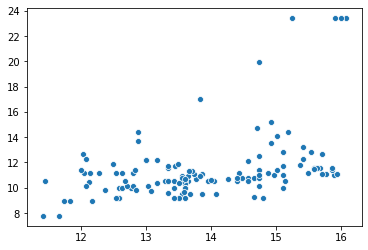

In [29]:
# scater(cor_tab,"Bất động sản và Xây dựng")

In [1]:
unna_tab

NameError: name 'unna_tab' is not defined